###KARNATAKA STATE RAINFALL ANALYSIS

Mount the Google Drive for data access

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data_path = '/content/drive/My Drive/Rainfall-dataset-2022to1901/'

In [ ]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import zscore

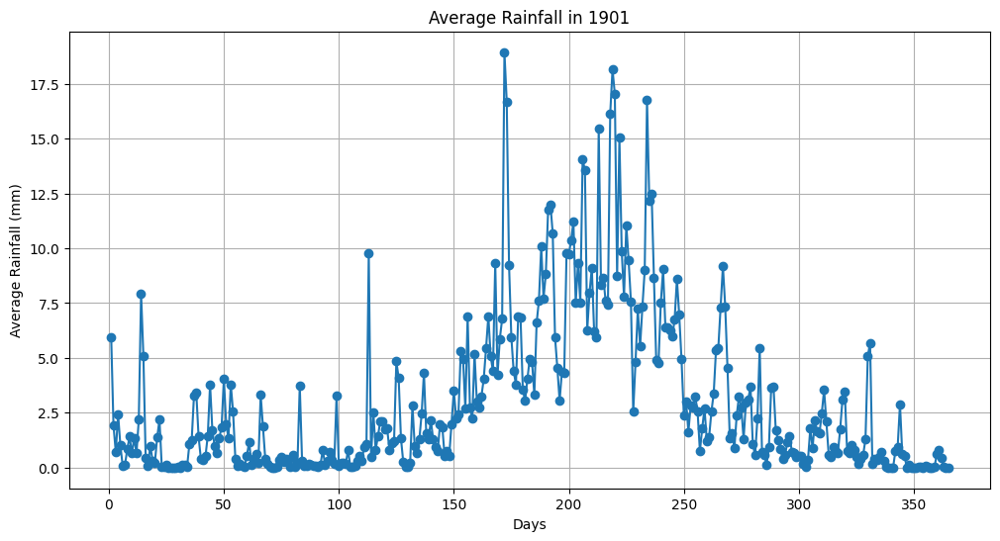

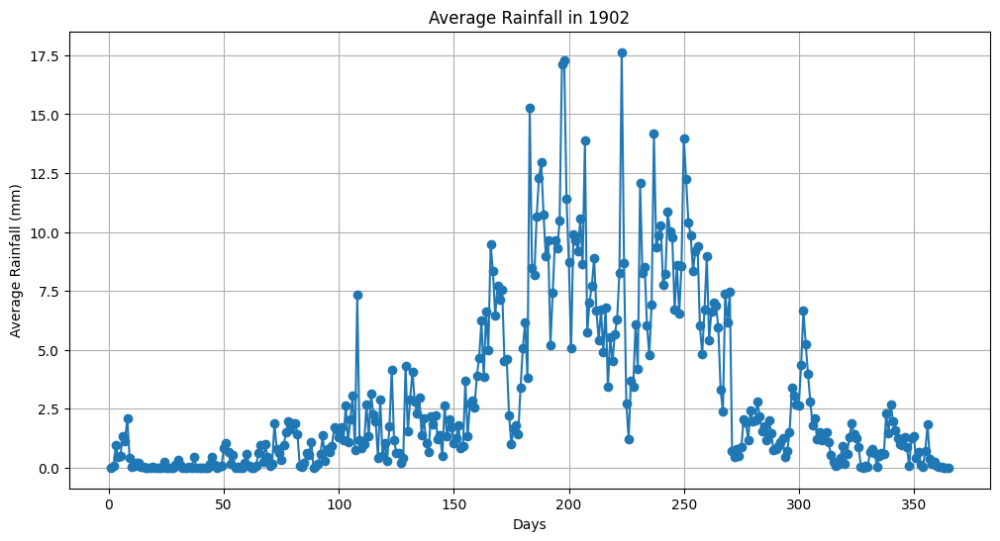

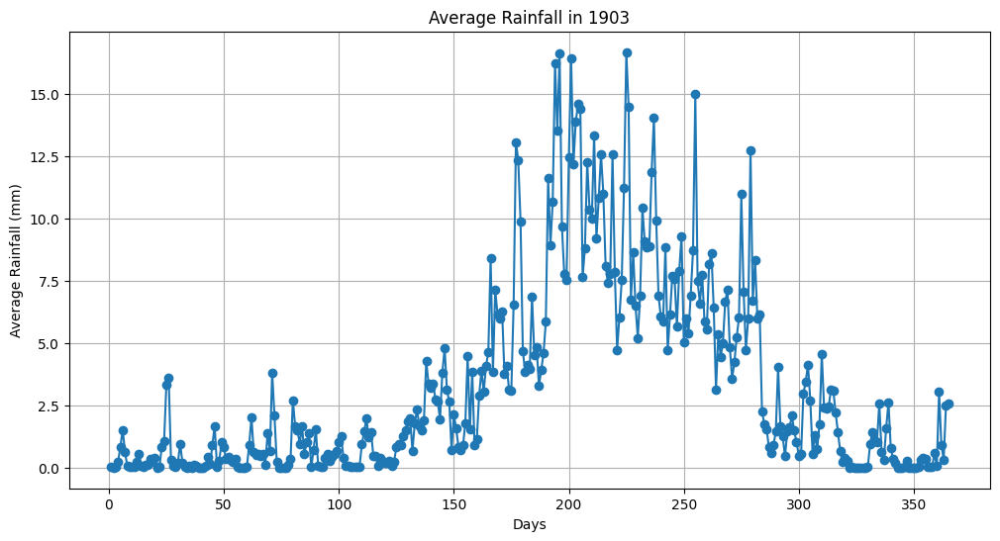

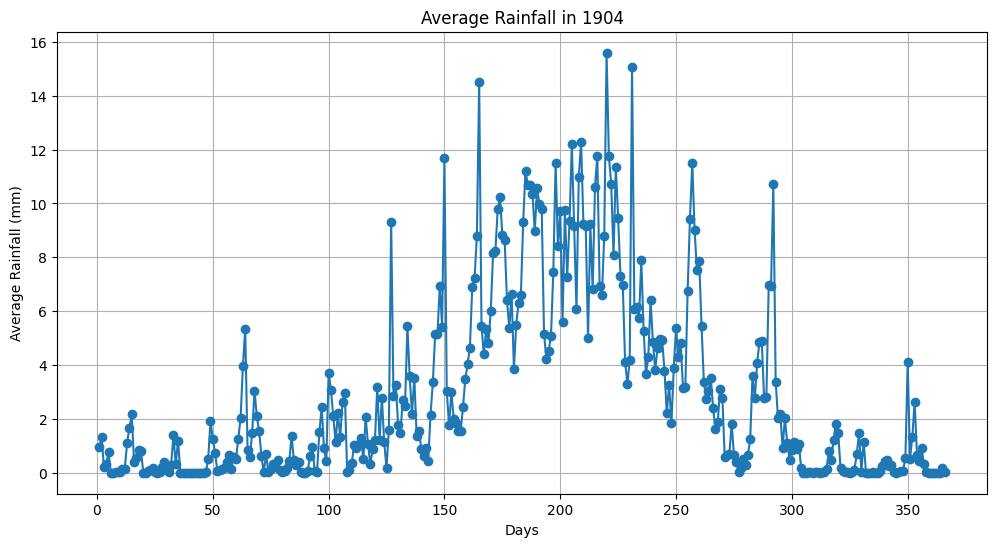

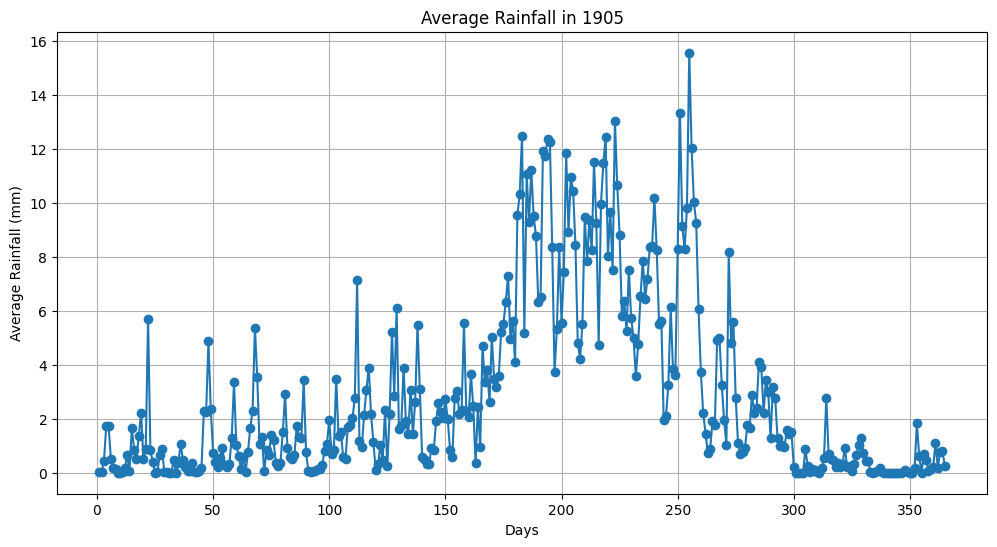

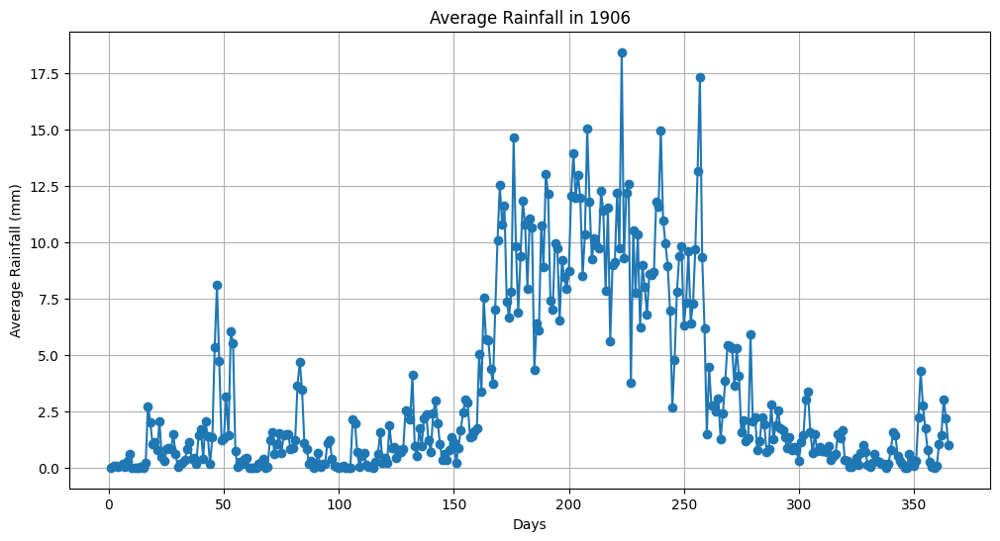

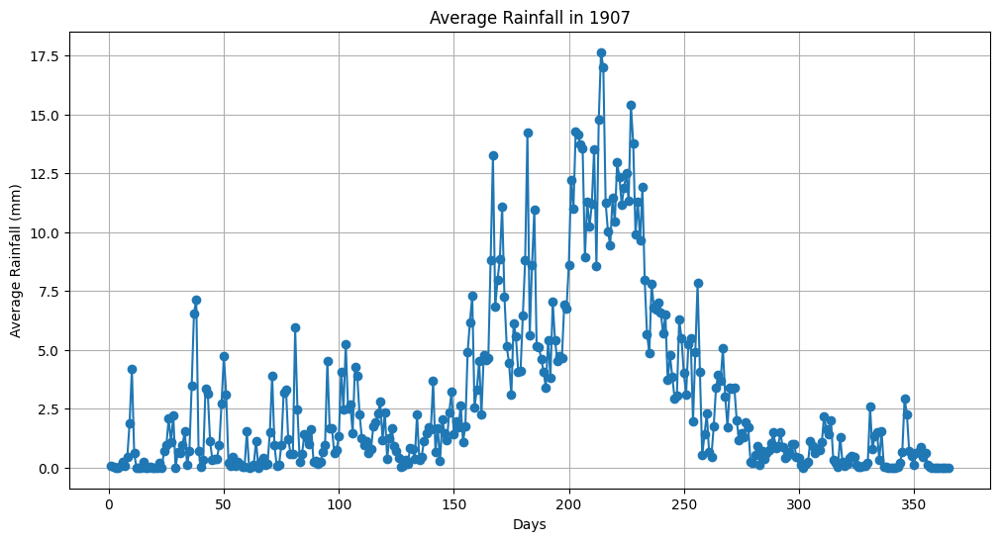

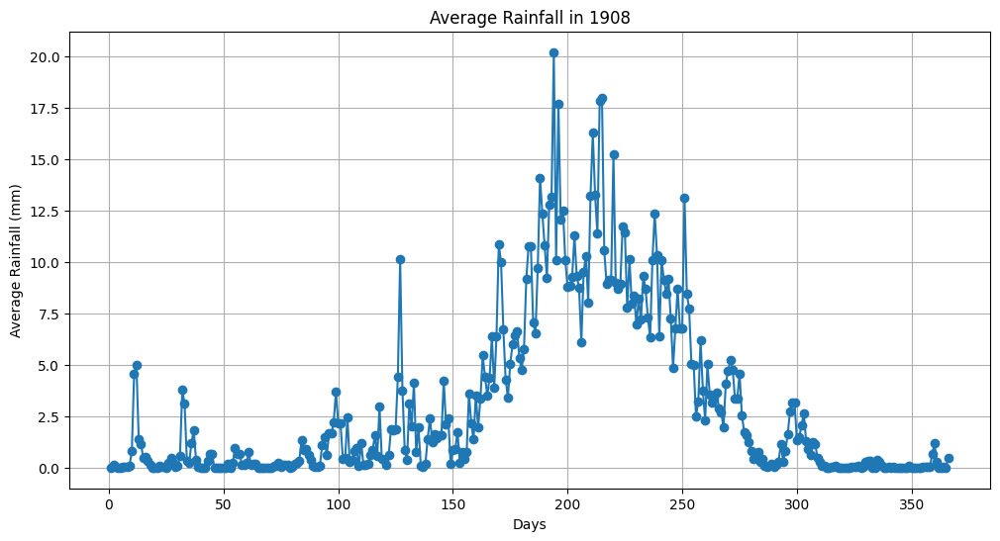

/usr/local/lib/python3.10/dist-packages/scipy/io/_netcdf.py:305: RuntimeWarning: Cannot close a netcdf_file opened with mmap=True, when netcdf_variables or arrays referring to its data still exist. All data arrays obtained from such files refer directly to data on disk, and must be copied before the file can be cleanly closed. (See netcdf_file docstring for more information on mmap.)
  warnings.warn((


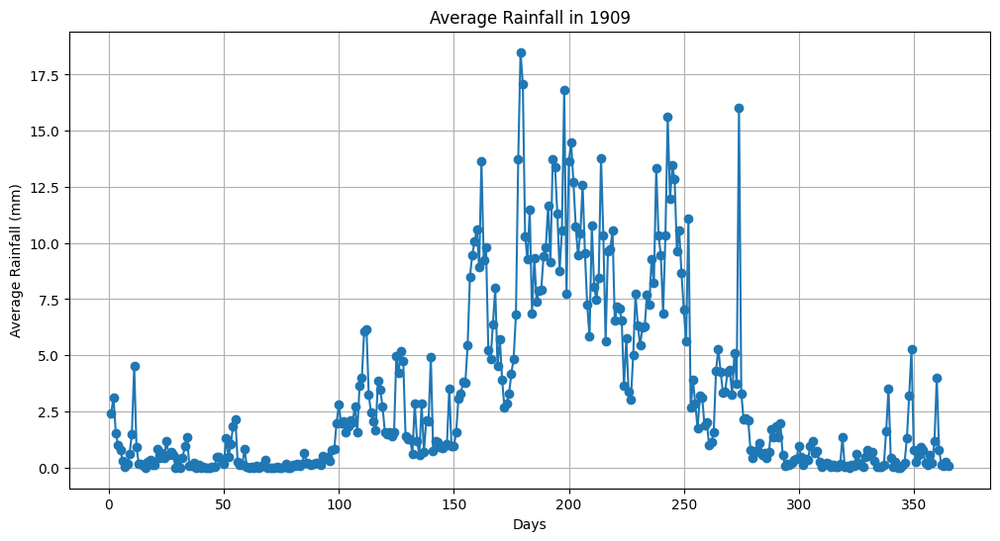

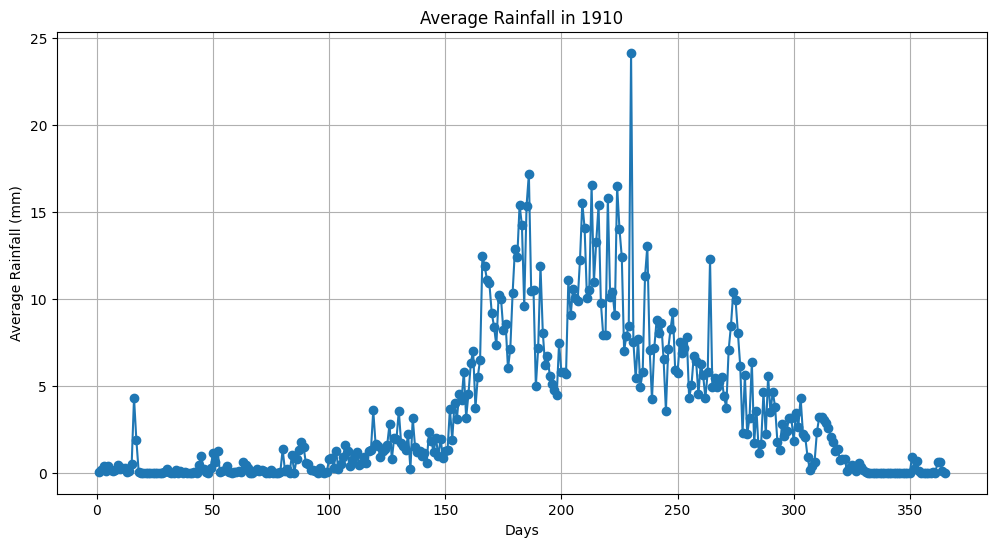

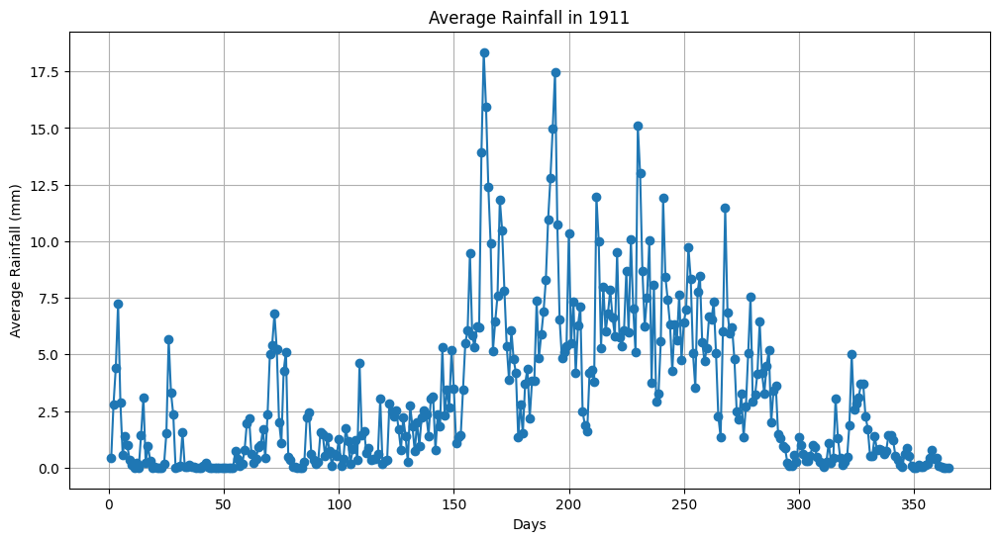

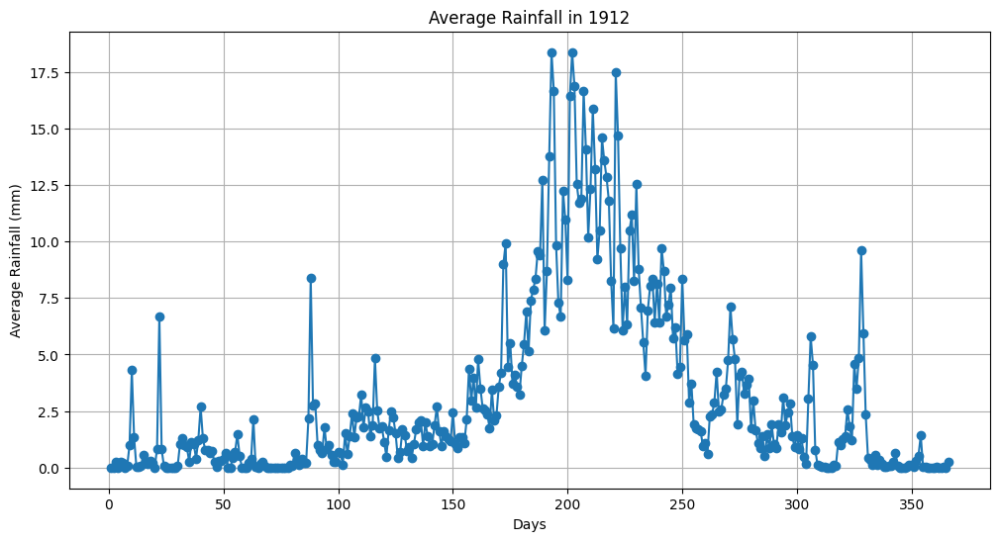

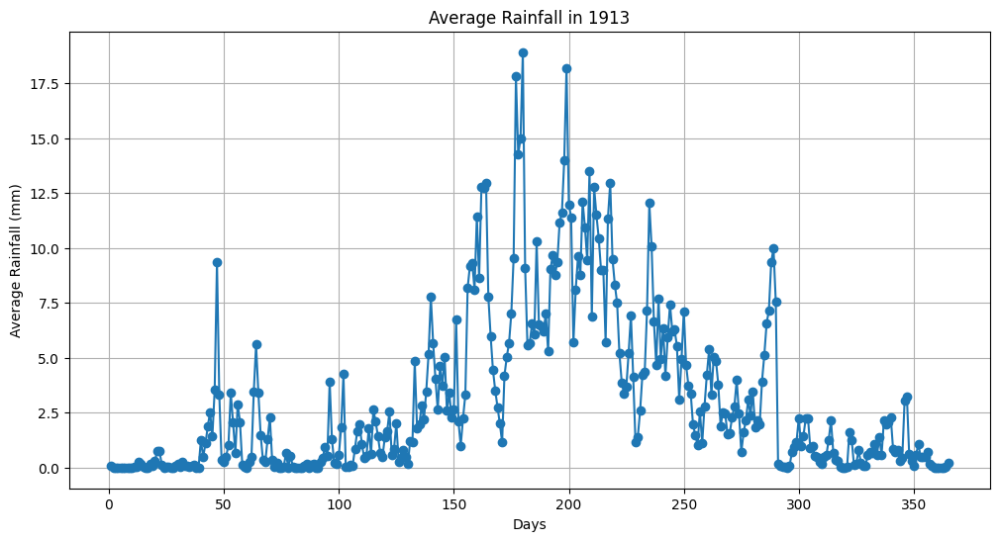

...

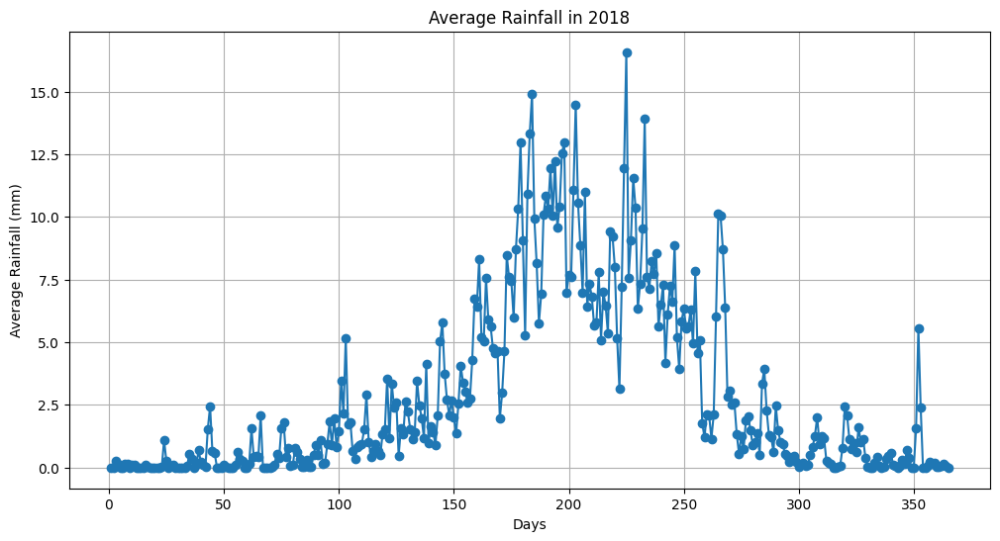

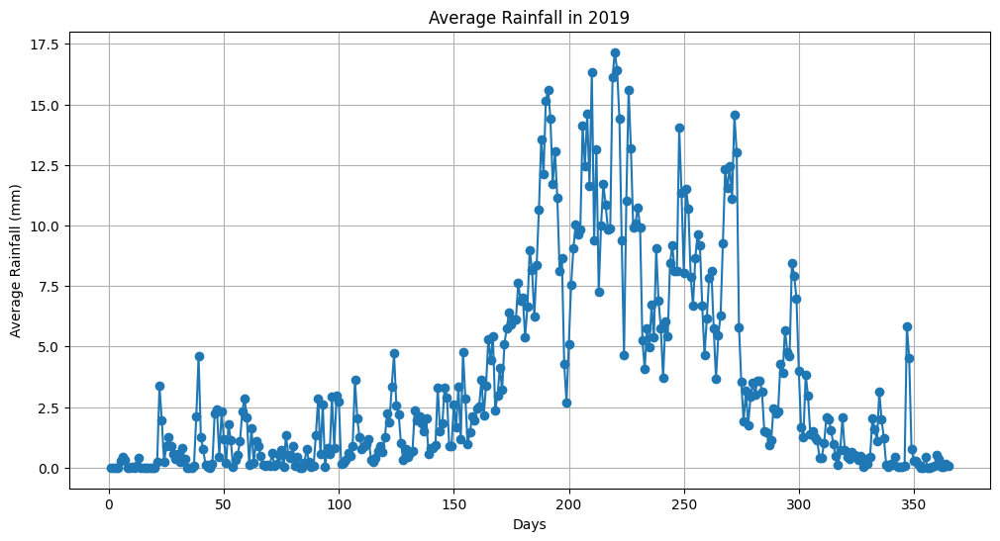

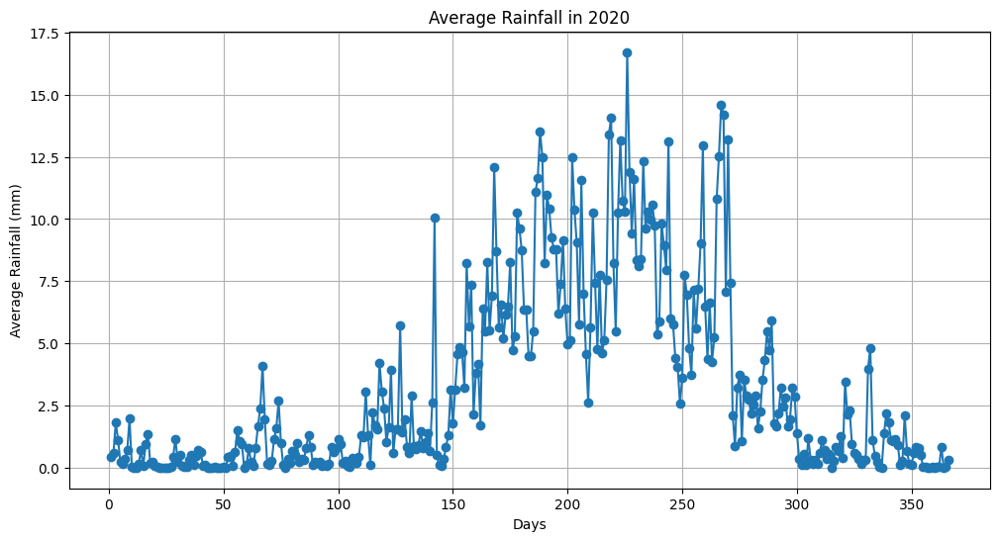

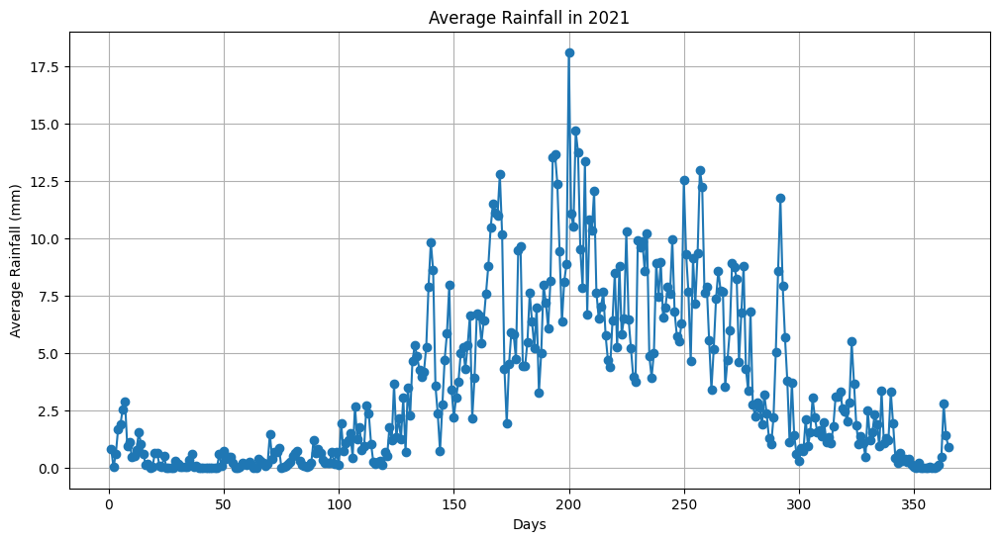

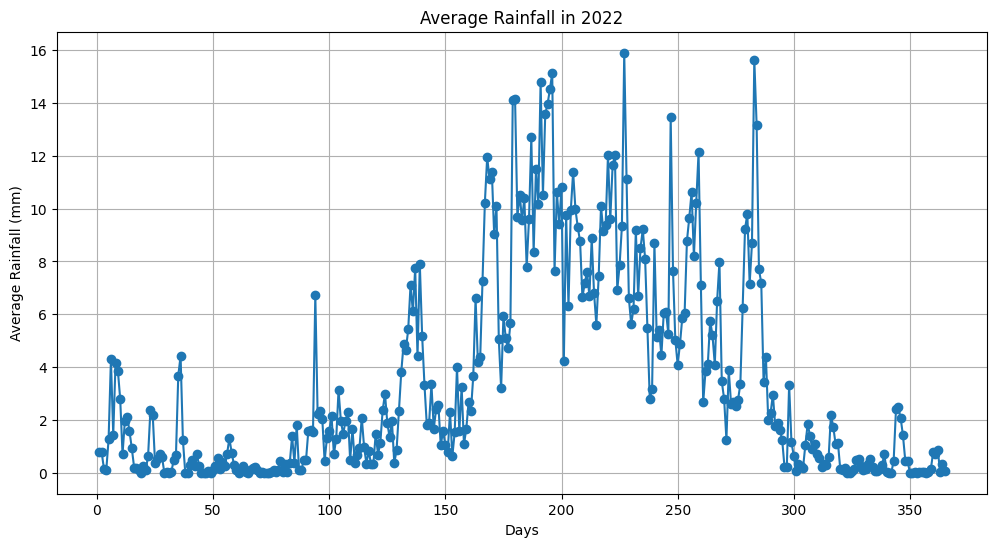

In [ ]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt

# Load the NetCDF file
file_pattern = '{year}.nc'

# Load all NetCDF files
years = np.arange(1901, 2023)
ds_list = [xr.open_dataset(data_path + file_pattern.format(year=year)) for year in years]
# latitude and longitude ranges for Karnataka
lat_min = 11.30  # Minimum latitude
lat_max = 18.30  # Maximum latitude
lon_min = 74.00  # Minimum longitude
lon_max = 78.30  # Maximum longitude

# Filter the NetCDF files to include only those within the defined latitude and longitude ranges
ds_list = [ds for ds in ds_list if (ds['LATITUDE'].min() >= lat_min and ds['LATITUDE'].max() <= lat_max) and (ds['LONGITUDE'].min() >= lon_min and ds['LONGITUDE'].max() <= lon_max)]


# Calculate annual average rainfall for each year
for year in years:
    ds = xr.open_dataset(data_path + file_pattern.format(year=year))
    annual_avg_rainfall = ds['RAINFALL'].mean(dim=['LATITUDE', 'LONGITUDE'])

    # Plot the average rainfall for the current year
    plt.figure(figsize=(12, 6))
    plt.plot(np.arange(1, len(annual_avg_rainfall.data) + 1), annual_avg_rainfall.data, marker='o', linestyle='-')
    plt.xlabel('Days')
    plt.ylabel('Average Rainfall (mm)')
    plt.title(f'Average Rainfall in {year}')
    plt.grid(True)
    plt.show()


In [ ]:
ds = xr.open_dataset(data_path + file_pattern.format(year=2022))
print(ds)
ds

<xarray.Dataset>
Dimensions:    (LONGITUDE: 35, LATITUDE: 33, TIME: 365)
Coordinates:
  * LONGITUDE  (LONGITUDE) float64 66.5 67.5 68.5 69.5 ... 97.5 98.5 99.5 100.5
  * LATITUDE   (LATITUDE) float64 6.5 7.5 8.5 9.5 10.5 ... 35.5 36.5 37.5 38.5
  * TIME       (TIME) datetime64[ns] 2022-01-01 2022-01-02 ... 2022-12-31
Data variables:
    RAINFALL   (TIME, LATITUDE, LONGITUDE) float64 ...
Attributes:
    history:      FERRET V7.5 (optimized) 19-Jan-23
    Conventions:  CF-1.6


<xarray.Dataset>
Dimensions:    (LONGITUDE: 35, LATITUDE: 33, TIME: 365)
Coordinates:
  * LONGITUDE  (LONGITUDE) float64 66.5 67.5 68.5 69.5 ... 97.5 98.5 99.5 100.5
  * LATITUDE   (LATITUDE) float64 6.5 7.5 8.5 9.5 10.5 ... 35.5 36.5 37.5 38.5
  * TIME       (TIME) datetime64[ns] 2022-01-01 2022-01-02 ... 2022-12-31
Data variables:
    RAINFALL   (TIME, LATITUDE, LONGITUDE) float64 ...
Attributes:
    history:      FERRET V7.5 (optimized) 19-Jan-23
    Conventions:  CF-1.6

In [ ]:
#load India shapefile
import geopandas as gpd
India_shapefile_path = '/content/drive/My Drive/AmmuProject/IndiaDisShapefile/output.shp'
India_shapefile = gpd.read_file(India_shapefile_path)

In [ ]:
Karnataka_shapefile = India_shapefile[India_shapefile['statename'] == 'Karnataka']

In [ ]:
import geopandas as gpd

# Extract the geometry of the Karnataka polygon
Karnataka_geometry = Karnataka_shapefile['geometry'].iloc[0]

# Get the bounding box (envelope) of the Karnataka polygon
Karnataka_bbox = Karnataka_geometry.bounds

# Extract latitude and longitude range
min_longitude, min_latitude, max_longitude, max_latitude = Karnataka_bbox

print(f"Latitude Range: {min_latitude} to {max_latitude}")
print(f"Longitude Range: {min_longitude} to {max_longitude}")

Latitude Range: 12.219870000364413 to 13.0550399996689
Longitude Range: 76.3323200002766 to 77.33436999983279


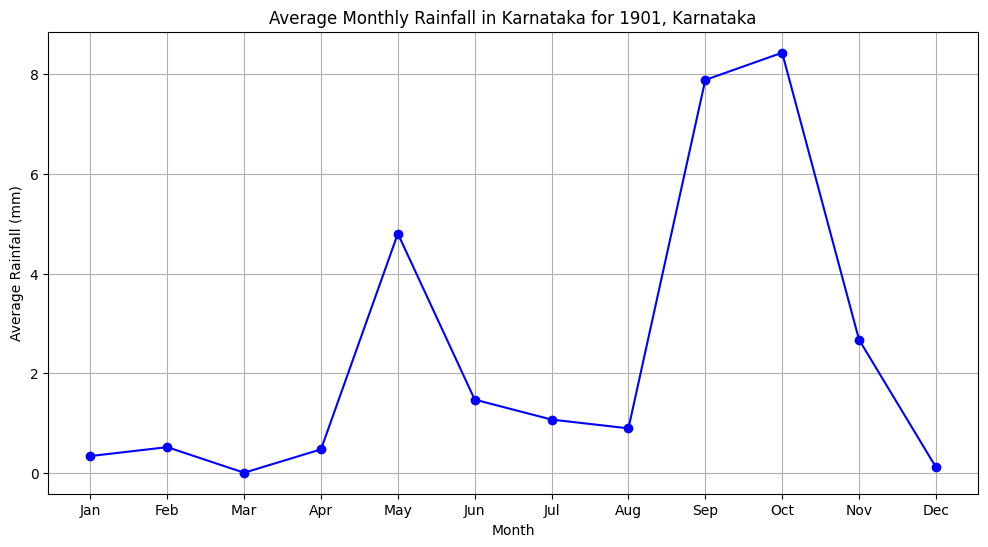

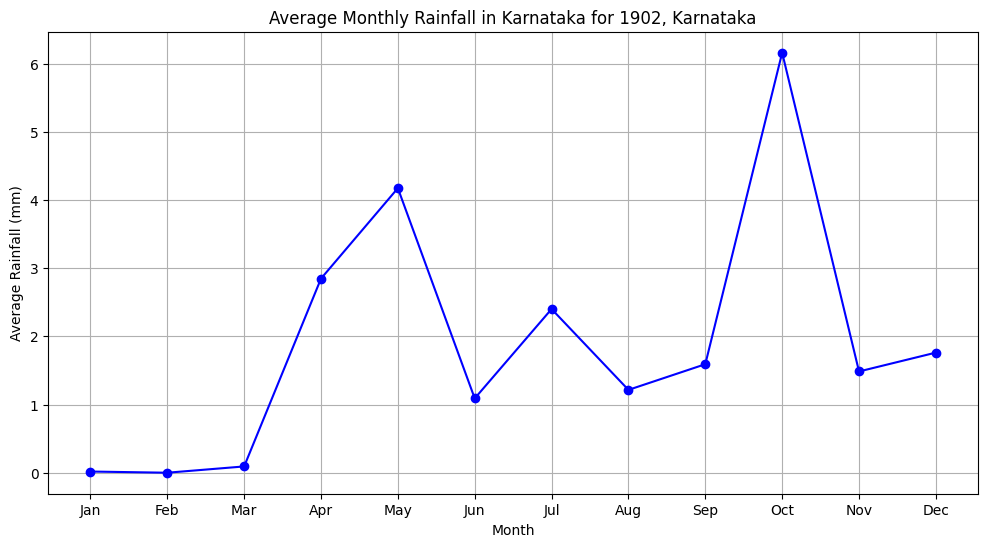

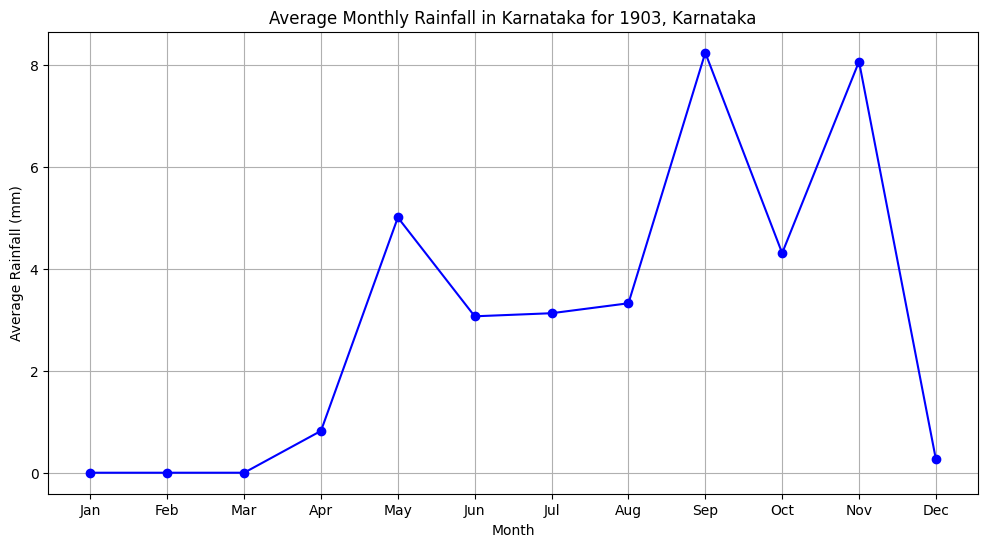

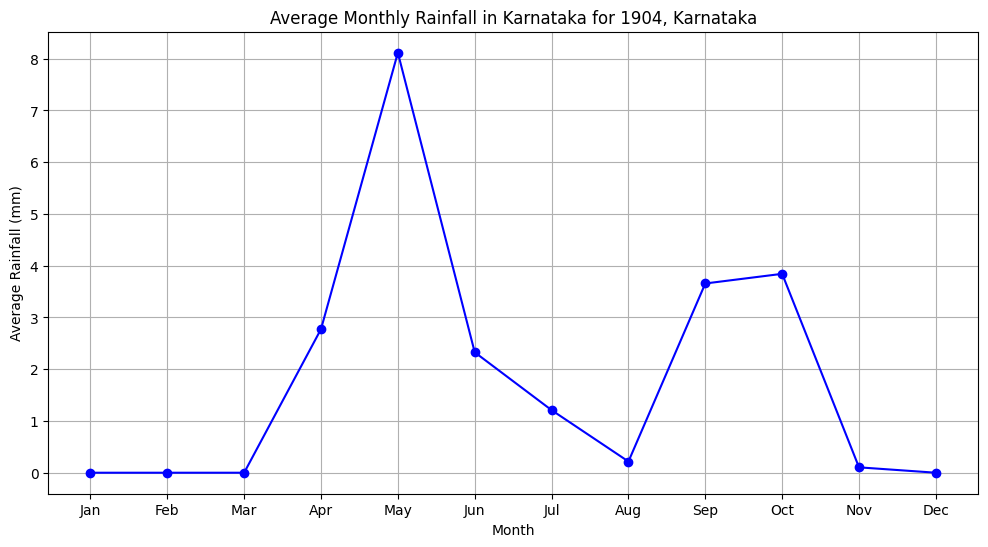

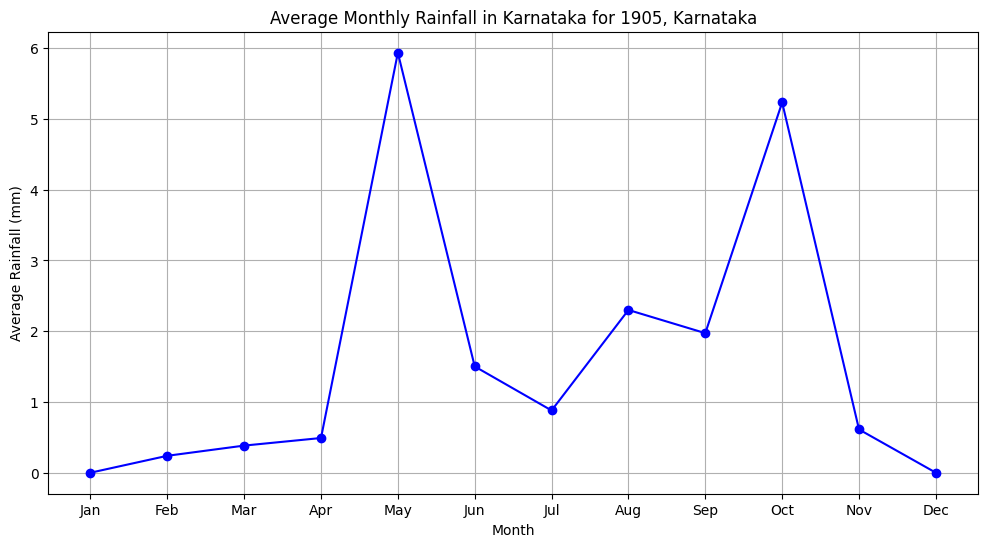

...

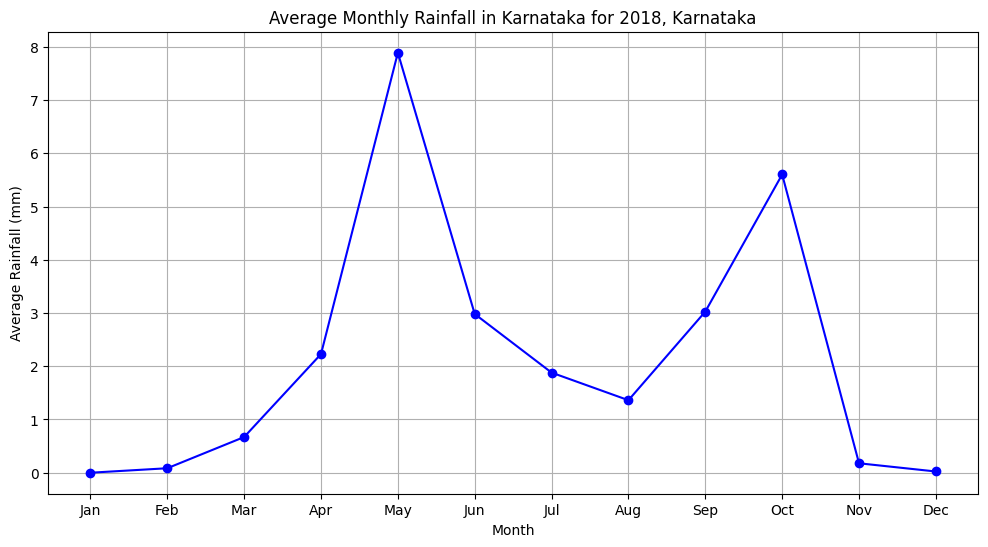

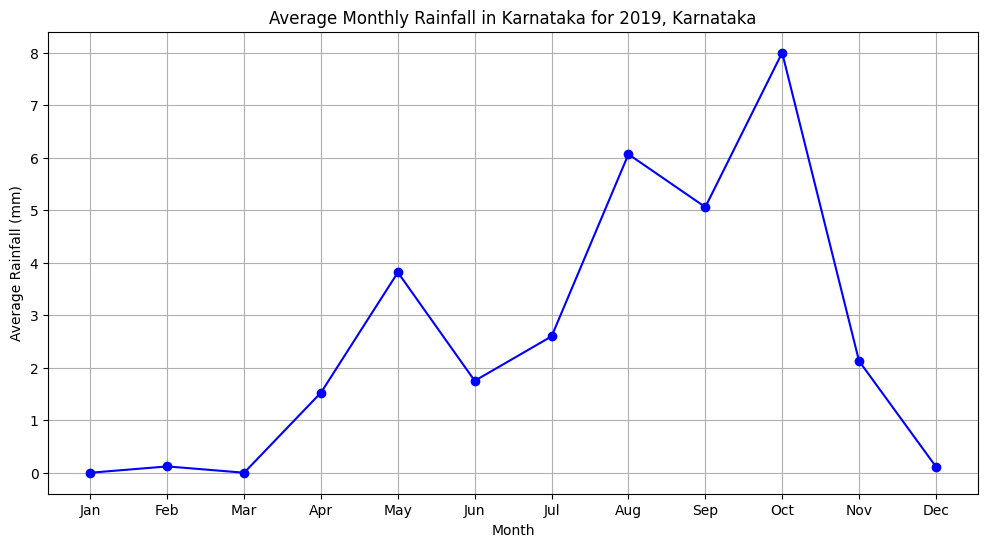

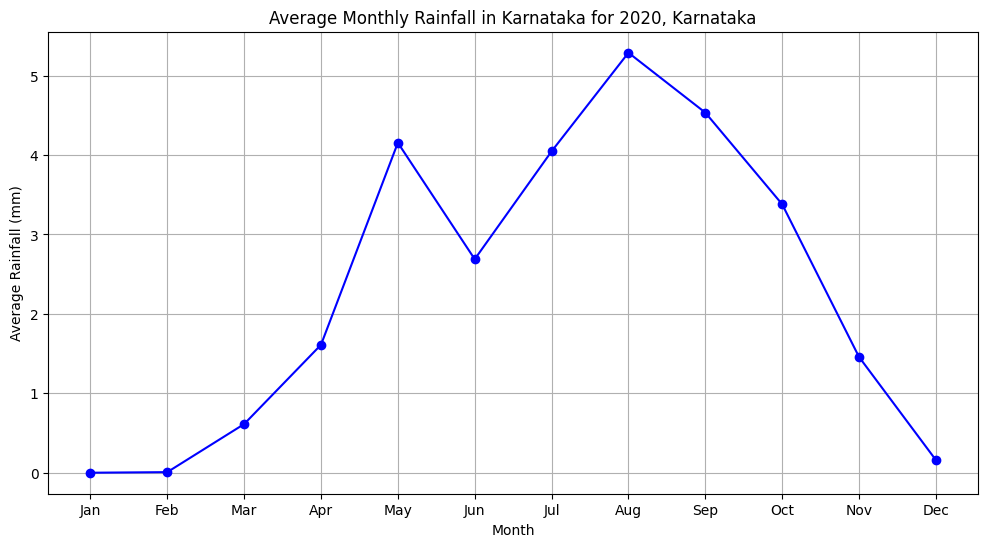

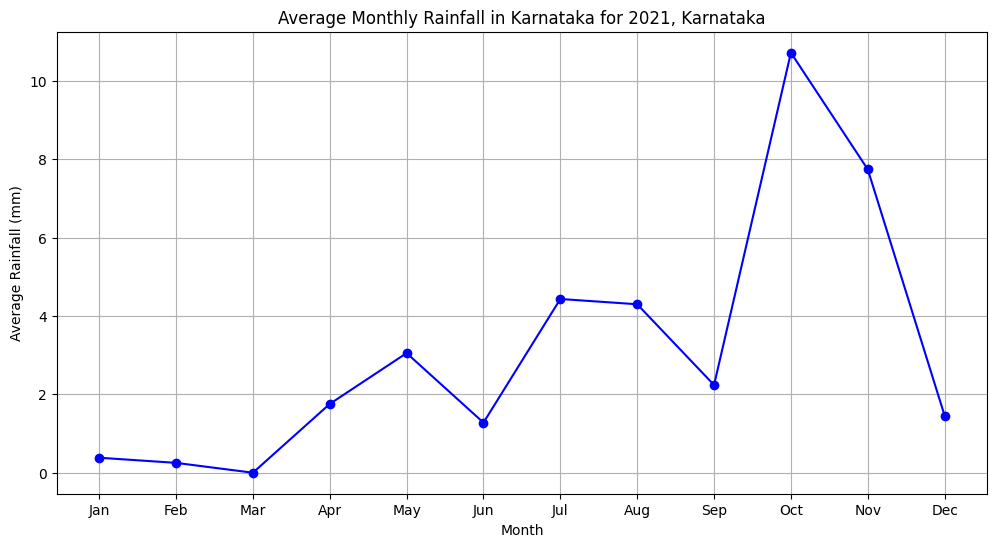

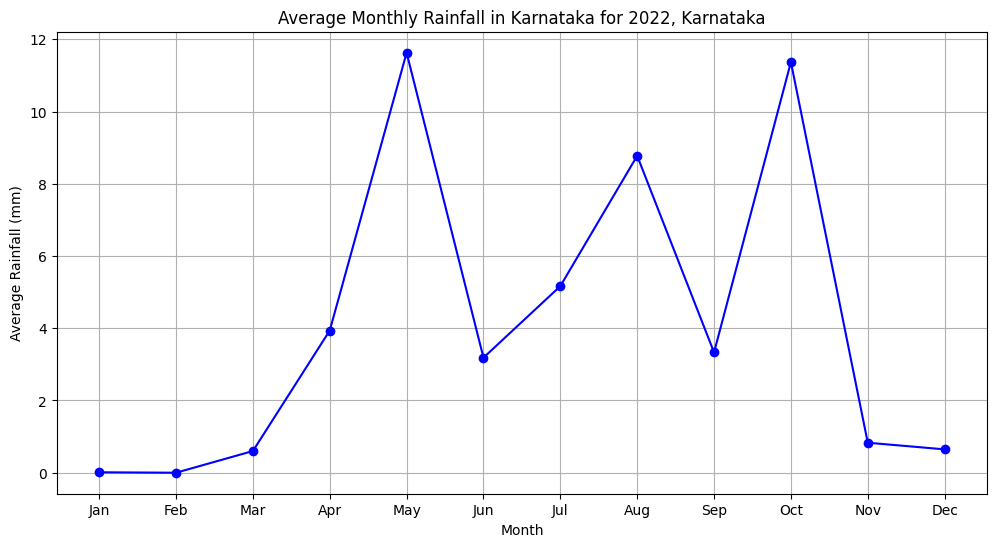

In [ ]:
# Loop through each year
for year in range(1901, 2023):
    # Load the rainfall data for the current year
    rainfall_data = xr.open_dataset(data_path + f'{year}.nc')

    months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

    # Find latitude and longitude indices within the Karnataka's boundaries
    latitude_indices = np.where((rainfall_data['LATITUDE'] >= min_latitude) & (rainfall_data['LATITUDE'] <= max_latitude))[0]
    longitude_indices = np.where((rainfall_data['LONGITUDE'] >= min_longitude) & (rainfall_data['LONGITUDE'] <= max_longitude))[0]

    # Slice the rainfall data for Karnataka
    Karnataka_rainfall_data = rainfall_data['RAINFALL'][:, latitude_indices, longitude_indices]

    # Resample the data to monthly averages
    Karnataka_monthly_average_rainfall = Karnataka_rainfall_data.resample(TIME='1M').mean()

    y_data = Karnataka_monthly_average_rainfall.values.squeeze()

    # Plot the average monthly rainfall using a line plot
    plt.figure(figsize=(12, 6))
    plt.plot(months, y_data, marker='o', linestyle='-', color='b')
    plt.xlabel('Month')
    plt.ylabel('Average Rainfall (mm)')
    plt.title(f'Average Monthly Rainfall in Karnataka for {year}, Karnataka')
    plt.grid(True)
    plt.show()


In [ ]:
import pandas as pd

dfs = []

for year in range(1901, 2023):
    # Load the rainfall data for the current year
    rainfall_data = xr.open_dataset(data_path + f'{year}.nc')

    months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

    # Find latitude and longitude indices within the Karnataka's boundaries
    latitude_indices = np.where((rainfall_data['LATITUDE'] >= min_latitude) & (rainfall_data['LATITUDE'] <= max_latitude))[0]
    longitude_indices = np.where((rainfall_data['LONGITUDE'] >= min_longitude) & (rainfall_data['LONGITUDE'] <= max_longitude))[0]

    # Slice the rainfall data for the current district
    Karnataka_rainfall_data['year'] = rainfall_data['RAINFALL'][:, latitude_indices, longitude_indices]

    # Resample the data to monthly averages
    Karnataka_monthly_average_rainfall['year'] = Karnataka_rainfall_data.resample(TIME='1M').mean()

    df_year = pd.DataFrame({
        'Year': [year] * len(months),
        'Month': months,
        'Average Rainfall':Karnataka_monthly_average_rainfall.values.tolist()
    })

    # Append the DataFrame to the list
    dfs.append(df_year)

# Concatenate all DataFrames into a single DataFrame
result_df = pd.concat(dfs, ignore_index=True)

# Print the results
print(result_df)

      Year Month          Average Rainfall
0     1901   Jan  [[0.012348027959946663]]
1     1901   Feb                   [[0.0]]
2     1901   Mar    [[0.6005837417417957]]
3     1901   Apr    [[3.9363909994562465]]
4     1901   May    [[11.627368922195126]]
...    ...   ...                       ...
1459  2022   Aug      [[8.77319906700042]]
1460  2022   Sep     [[3.330908058087031]]
1461  2022   Oct    [[11.368532984006789]]
1462  2022   Nov    [[0.8306896979610126]]
1463  2022   Dec    [[0.6465541239707701]]

[1464 rows x 3 columns]


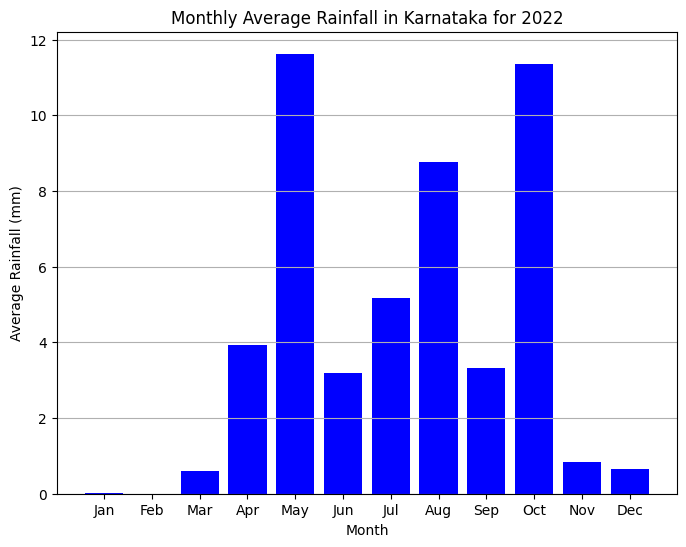

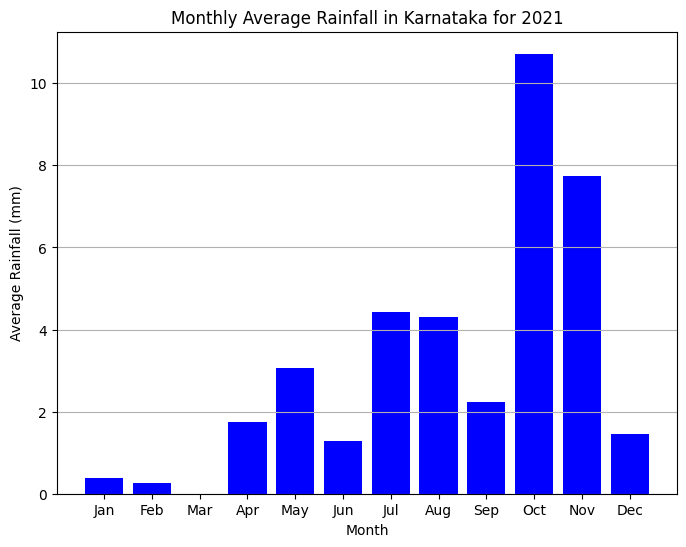

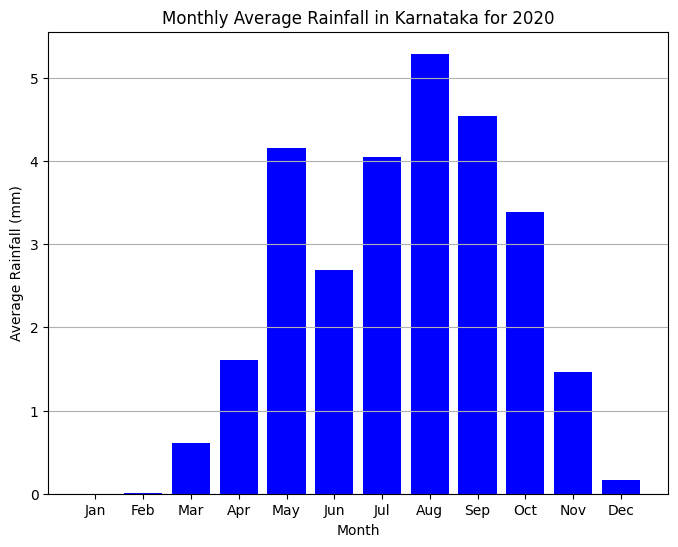

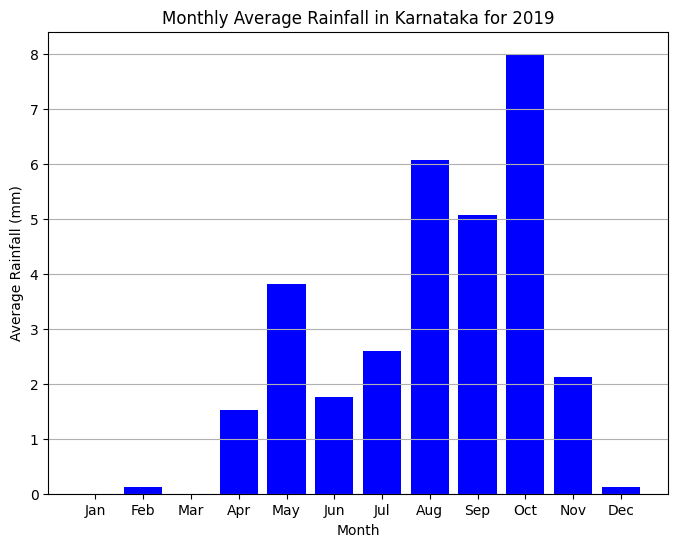

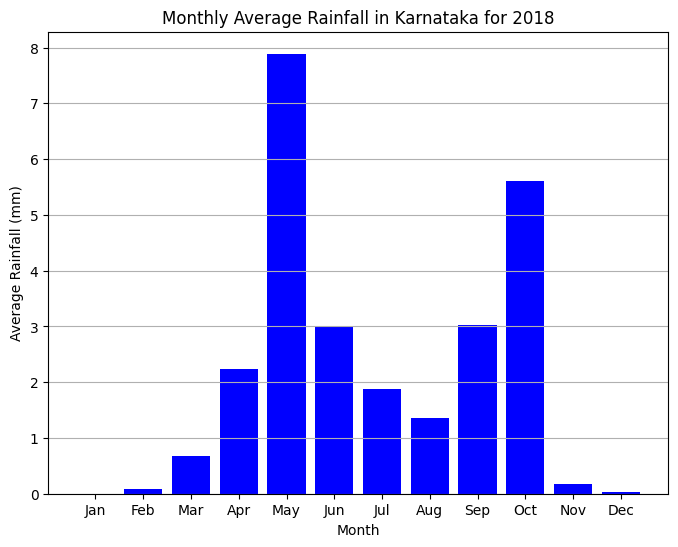

...

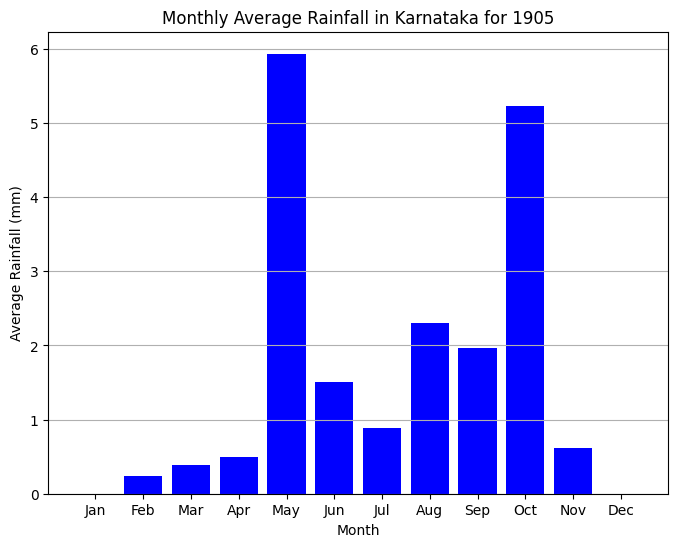

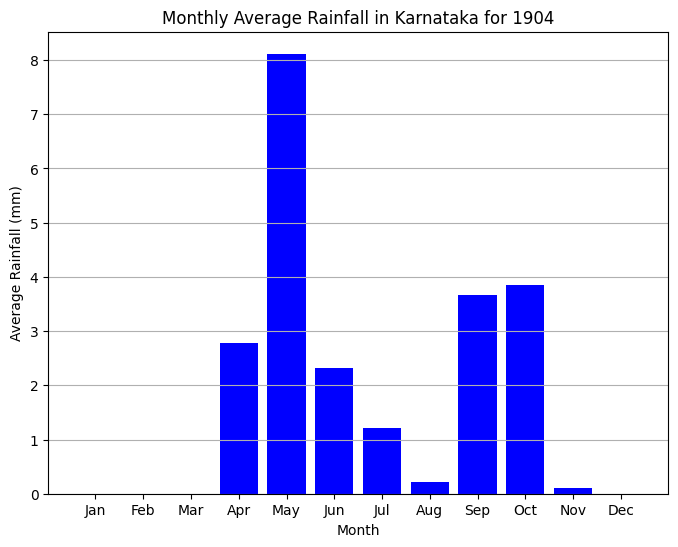

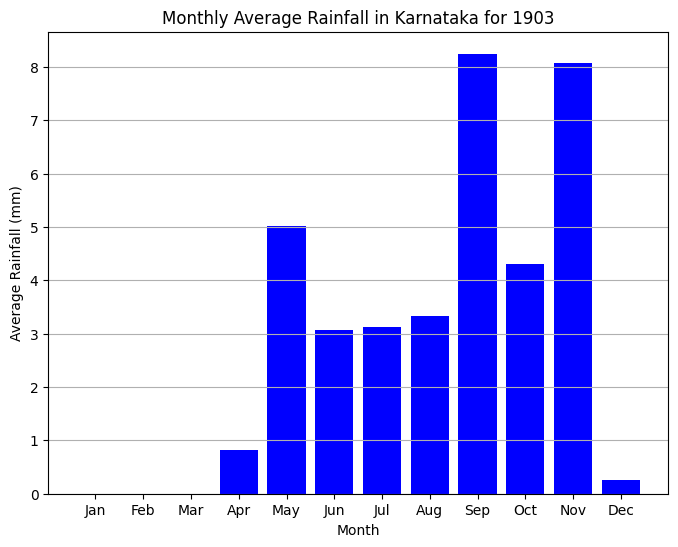

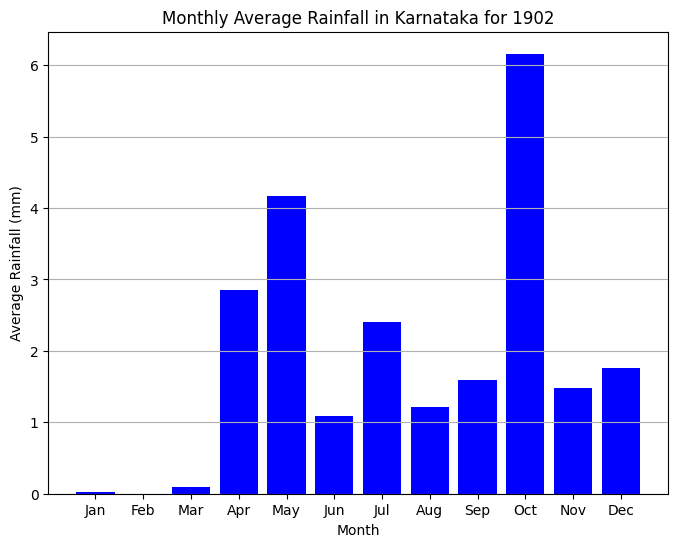

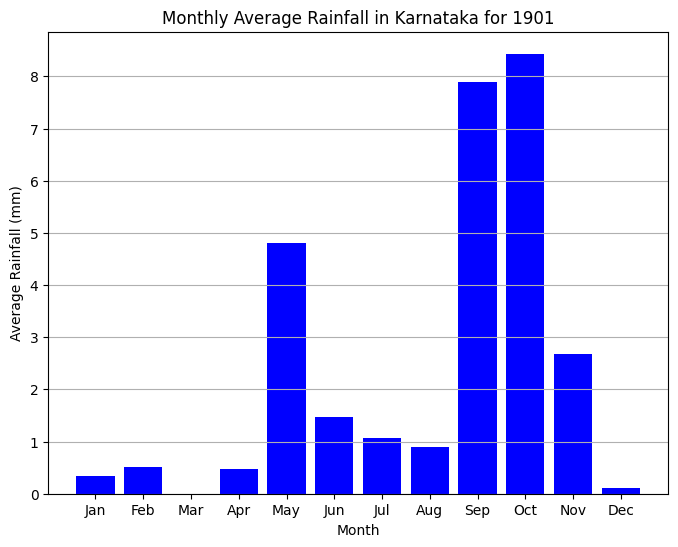

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr


# Loop through each year in descending order (from 2022 to 1901)
for year in range(2022, 1900, -1):
    # Load the rainfall data for the current year
    rainfall_data = xr.open_dataset(data_path + f'{year}.nc')

    months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

    # Find latitude and longitude indices within Karnataka's boundaries
    latitude_indices = np.where((rainfall_data['LATITUDE'] >= min_latitude) & (rainfall_data['LATITUDE'] <= max_latitude))[0]
    longitude_indices = np.where((rainfall_data['LONGITUDE'] >= min_longitude) & (rainfall_data['LONGITUDE'] <= max_longitude))[0]

    # Slice the rainfall data for Karnataka
    Karnataka_rainfall_data = rainfall_data['RAINFALL'][:, latitude_indices, longitude_indices]

    # Resample the data to monthly averages
    Karnataka_monthly_average_rainfall = Karnataka_rainfall_data.resample(TIME='1M').mean()

    # Extract the monthly average rainfall values
    y_data = Karnataka_monthly_average_rainfall.values.squeeze()

    # Plot the average monthly rainfall using a histogram
    plt.figure(figsize=(8, 6))
    plt.bar(months, y_data, color='b')
    plt.xlabel('Month')
    plt.ylabel('Average Rainfall (mm)')
    plt.title(f'Monthly Average Rainfall in Karnataka for {year}')
    plt.grid(axis='y')
    plt.show()

    # Close the NetCDF dataset to free up resources
    rainfall_data.close()



Display how the rainfall trends over the years per month have changed

In [ ]:
import calendar


/usr/local/lib/python3.10/dist-packages/scipy/io/_netcdf.py:305: RuntimeWarning: Cannot close a netcdf_file opened with mmap=True, when netcdf_variables or arrays referring to its data still exist. All data arrays obtained from such files refer directly to data on disk, and must be copied before the file can be cleanly closed. (See netcdf_file docstring for more information on mmap.)
  warnings.warn((


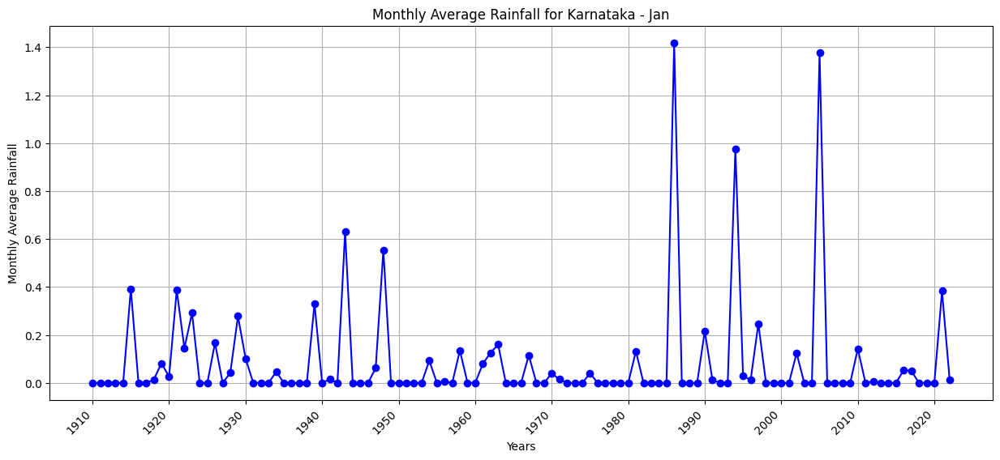

/usr/local/lib/python3.10/dist-packages/scipy/io/_netcdf.py:305: RuntimeWarning: Cannot close a netcdf_file opened with mmap=True, when netcdf_variables or arrays referring to its data still exist. All data arrays obtained from such files refer directly to data on disk, and must be copied before the file can be cleanly closed. (See netcdf_file docstring for more information on mmap.)
  warnings.warn((


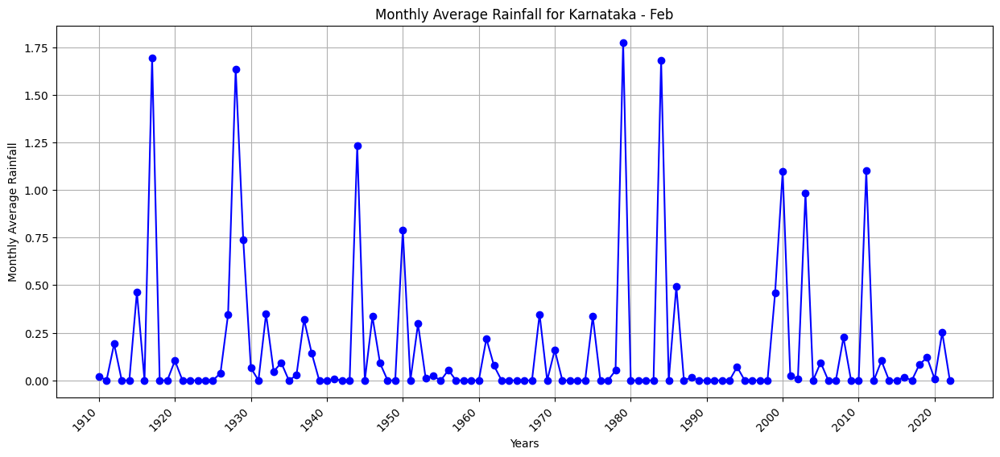

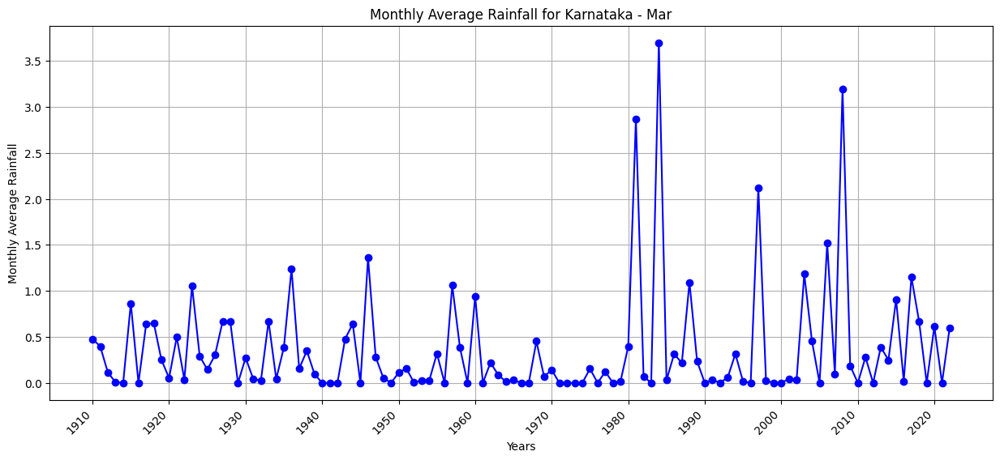

/usr/local/lib/python3.10/dist-packages/scipy/io/_netcdf.py:305: RuntimeWarning: Cannot close a netcdf_file opened with mmap=True, when netcdf_variables or arrays referring to its data still exist. All data arrays obtained from such files refer directly to data on disk, and must be copied before the file can be cleanly closed. (See netcdf_file docstring for more information on mmap.)
  warnings.warn((


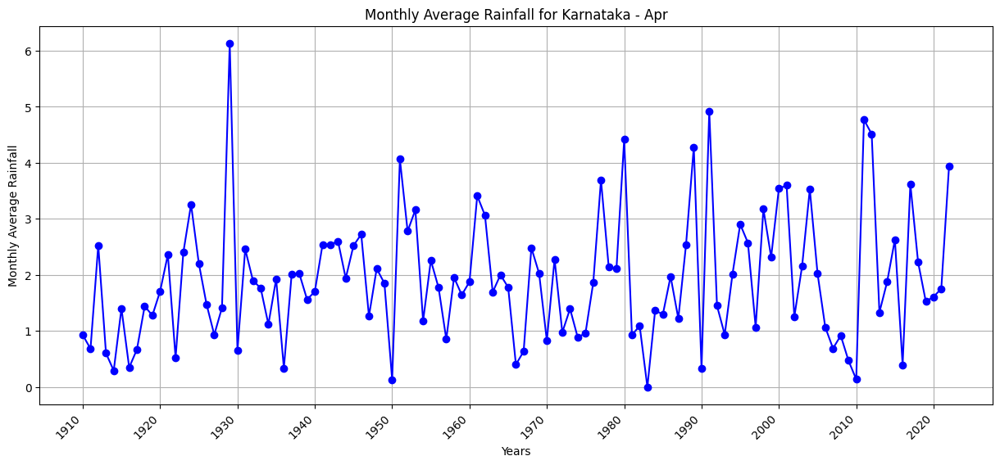

/usr/local/lib/python3.10/dist-packages/scipy/io/_netcdf.py:305: RuntimeWarning: Cannot close a netcdf_file opened with mmap=True, when netcdf_variables or arrays referring to its data still exist. All data arrays obtained from such files refer directly to data on disk, and must be copied before the file can be cleanly closed. (See netcdf_file docstring for more information on mmap.)
  warnings.warn((


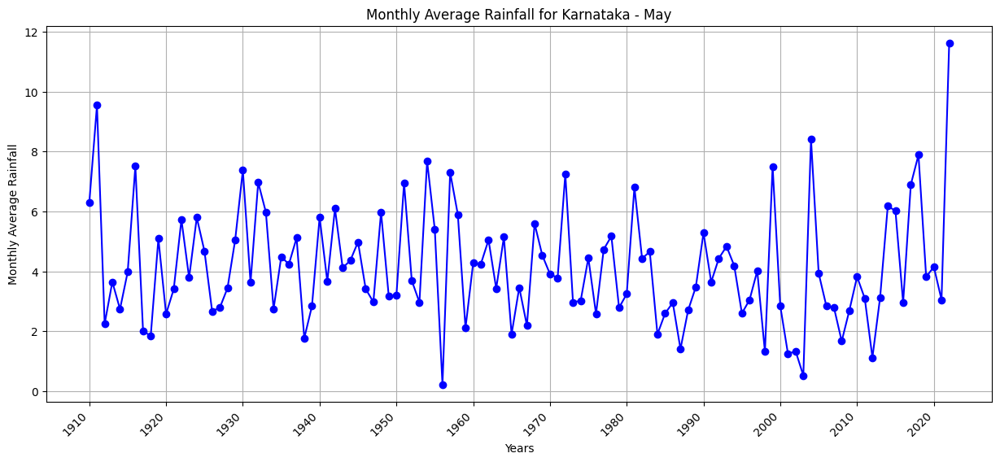

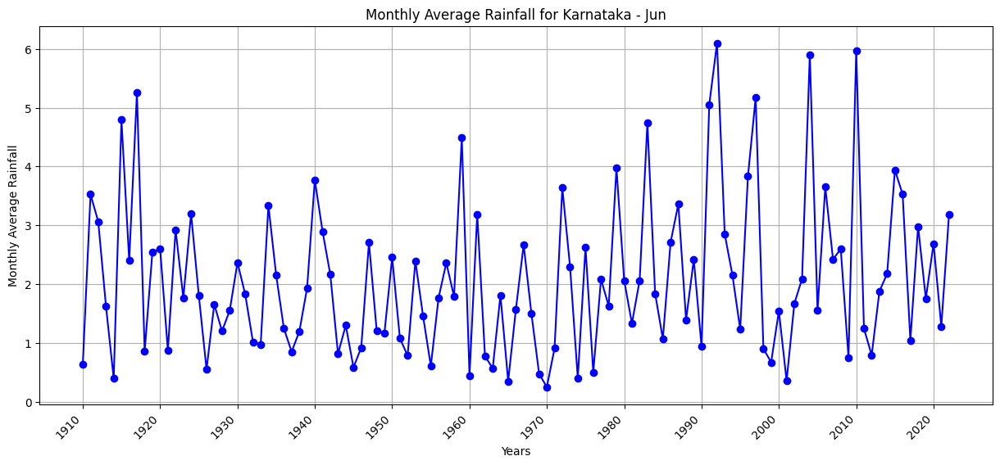

/usr/local/lib/python3.10/dist-packages/scipy/io/_netcdf.py:305: RuntimeWarning: Cannot close a netcdf_file opened with mmap=True, when netcdf_variables or arrays referring to its data still exist. All data arrays obtained from such files refer directly to data on disk, and must be copied before the file can be cleanly closed. (See netcdf_file docstring for more information on mmap.)
  warnings.warn((


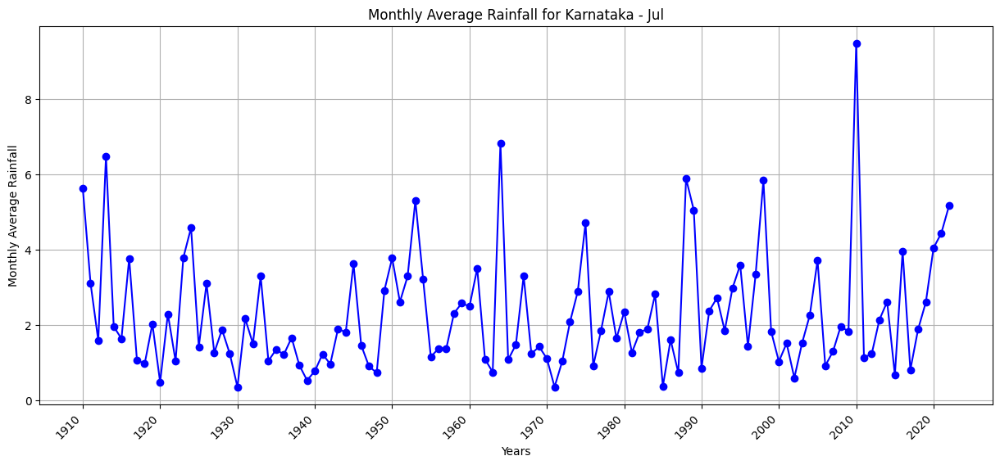

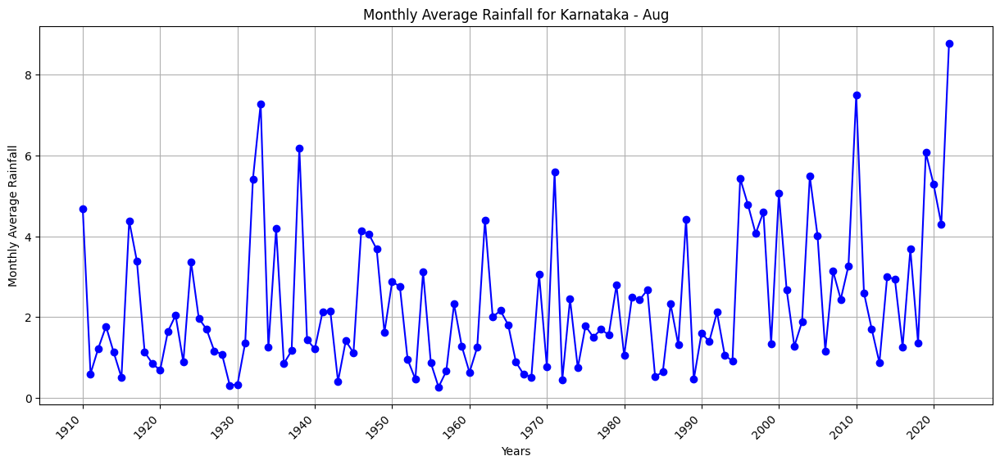

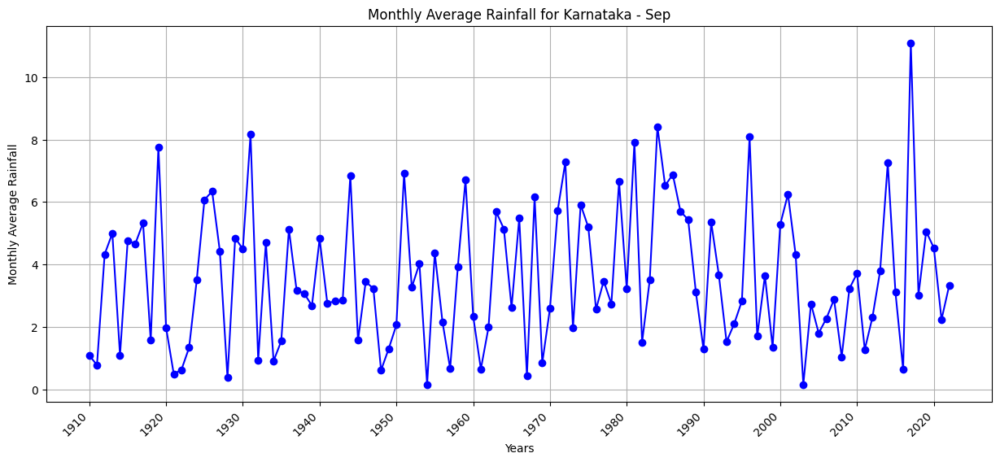

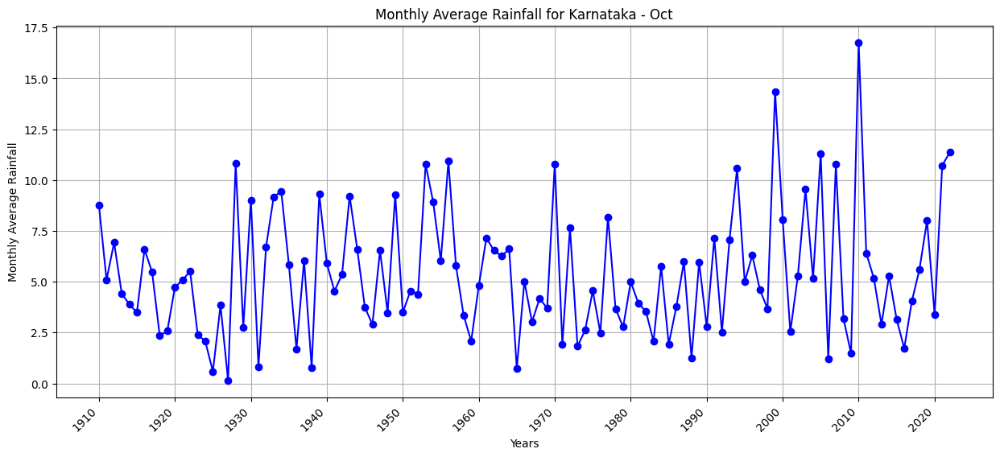

/usr/local/lib/python3.10/dist-packages/scipy/io/_netcdf.py:305: RuntimeWarning: Cannot close a netcdf_file opened with mmap=True, when netcdf_variables or arrays referring to its data still exist. All data arrays obtained from such files refer directly to data on disk, and must be copied before the file can be cleanly closed. (See netcdf_file docstring for more information on mmap.)
  warnings.warn((


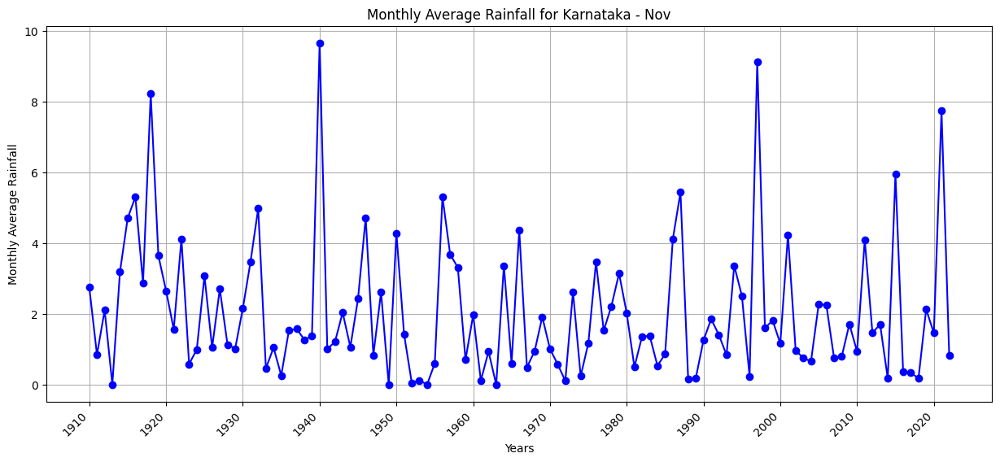

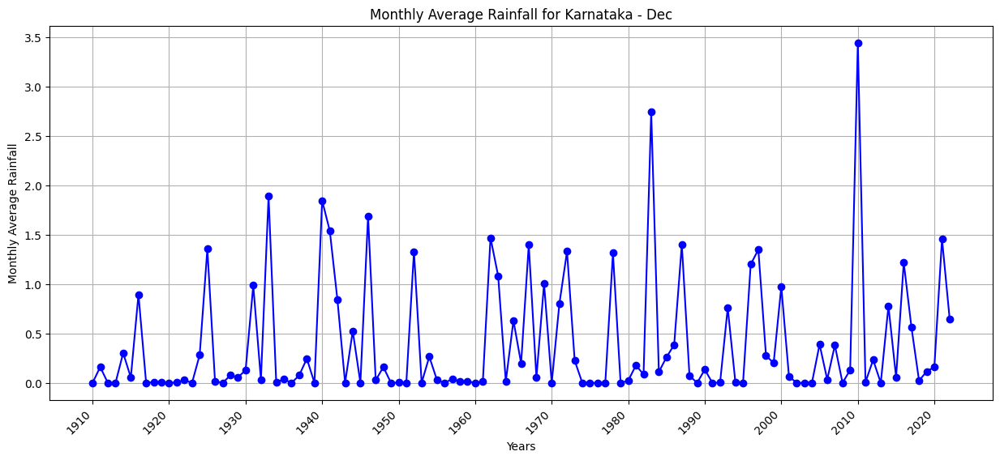

In [ ]:
# Initialize an empty list to store DataFrames
dfs = []

# Loop through each month
for month in range(1, 13):
    # Initialize an empty list to store monthly average values for each year
    monthly_averages = []

    # Loop through each year in descending order (from 2022 to 1910)
    for year in range(2022, 1909, -1):
        # Load the rainfall data for the current year
        rainfall_data = xr.open_dataset(data_path + f'{year}.nc')

        # Find latitude and longitude indices within Karnataka's boundaries
        latitude_indices = np.where((rainfall_data['LATITUDE'] >= min_latitude) & (rainfall_data['LATITUDE'] <= max_latitude))[0]
        longitude_indices = np.where((rainfall_data['LONGITUDE'] >= min_longitude) & (rainfall_data['LONGITUDE'] <= max_longitude))[0]

        # Slice the rainfall data for Karnataka
        karnataka_rainfall_data = rainfall_data['RAINFALL'][:, latitude_indices, longitude_indices]

        # Resample the data to monthly averages
        karnataka_monthly_average_rainfall = karnataka_rainfall_data.resample(TIME='1M').mean()

        # Extract the values for the specific month
        monthly_values = karnataka_monthly_average_rainfall.sel(TIME=f'{year}-{month:02d}').values.squeeze()

        # Append the monthly average value for the current year to the list
        monthly_averages.append(monthly_values.mean())

        # Close the NetCDF dataset to free up resources
        rainfall_data.close()

    # Create a DataFrame for the monthly averages for the current month
    result_df_for_month = pd.DataFrame({
        'Year': range(2022, 1909, -1),
        'Monthly Average': monthly_averages
    })

    # Plot the monthly averages for the current month
    plt.figure(figsize=(15, 6))
    plt.plot(result_df_for_month['Year'], result_df_for_month['Monthly Average'], marker='o', linestyle='-', color='b')
    plt.xlabel('Years')
    plt.ylabel('Monthly Average Rainfall')
    plt.title(f'Monthly Average Rainfall for Karnataka - {calendar.month_abbr[month]}')
    plt.xticks(np.arange(1910, 2023, 10), rotation=45, ha='right')
    plt.grid(True)
    plt.show()

    # Append the DataFrame for the current month to the list of DataFrames
    dfs.append(result_df_for_month)

# Concatenate all DataFrames into a single DataFrame
result_df = pd.concat(dfs, ignore_index=True)


Dynamic Time Wraping

In [ ]:
!pip install fastdtw

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fastdtw: filename=fastdtw-0.3.4-cp310-cp310-linux_x86_64.whl size=512576 sha256=c2e3536ee230608ec63f2b9663ed3131a6afd29ab61172a9533c5e02d667d1fe
  Stored in directory: /root/.cache/pip/wheels/73/c8/f7/c25448dab74c3acf4848bc25d513c736bb93910277e1528ef4
Successfully built fastdtw


In [ ]:
from fastdtw import fastdtw

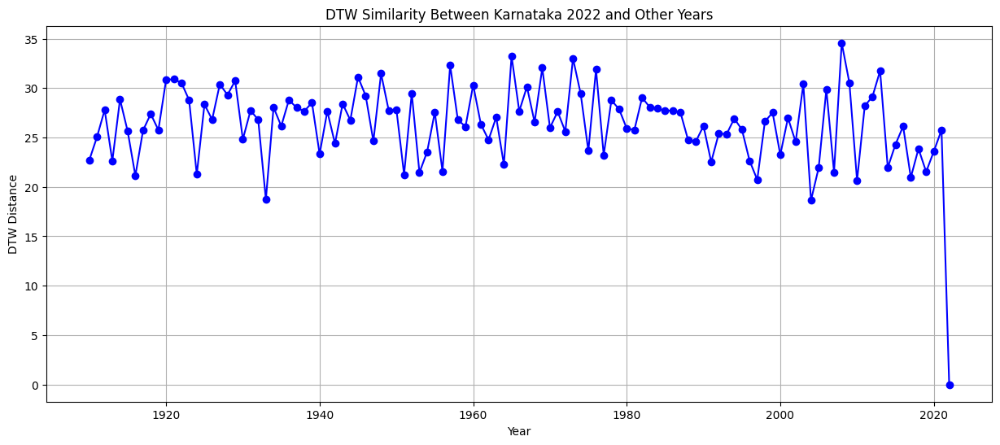

In [ ]:
# Select the specific year for comparison
reference_year = 2022

# Initialize an empty list to store DataFrames
dfs = []

# Load the rainfall data for the reference year
reference_data = xr.open_dataset(data_path + f'{reference_year}.nc')
latitude_indices_ref = np.where((reference_data['LATITUDE'] >= min_latitude) & (reference_data['LATITUDE'] <= max_latitude))[0]
longitude_indices_ref = np.where((reference_data['LONGITUDE'] >= min_longitude) & (reference_data['LONGITUDE'] <= max_longitude))[0]
karnataka_rainfall_data_ref = reference_data['RAINFALL'][:, latitude_indices_ref, longitude_indices_ref]
karnataka_monthly_average_rainfall_ref = karnataka_rainfall_data_ref.resample(TIME='1M').mean()

# Generate all possible pairs of years
year_pairs = [(year, reference_year) for year in range(1910, 2023)]

for year, _ in year_pairs:
    # Load the rainfall data for the current year
    rainfall_data = xr.open_dataset(data_path + f'{year}.nc')

    # Find latitude and longitude indices within Karnataka's boundaries
    latitude_indices = np.where((rainfall_data['LATITUDE'] >= min_latitude) & (rainfall_data['LATITUDE'] <= max_latitude))[0]
    longitude_indices = np.where((rainfall_data['LONGITUDE'] >= min_longitude) & (rainfall_data['LONGITUDE'] <= max_longitude))[0]

    # Slice the rainfall data for Karnataka
    karnataka_rainfall_data = rainfall_data['RAINFALL'][:, latitude_indices, longitude_indices]

    # Resample the data to monthly averages
    karnataka_monthly_average_rainfall = karnataka_rainfall_data.resample(TIME='1M').mean()

    # Calculate DTW distance
    dtw_distance, _ = fastdtw(karnataka_monthly_average_rainfall, karnataka_monthly_average_rainfall_ref)

    # Store the DTW distance and the corresponding year
    dfs.append({'Year': year, 'DTW Distance': dtw_distance})

# Create a DataFrame from the list of dictionaries
result_df = pd.DataFrame(dfs)

# Plot the DTW distances as a line graph
plt.figure(figsize=(15, 6))
plt.plot(result_df['Year'], result_df['DTW Distance'], marker='o', linestyle='-', color='b')
plt.xlabel('Year')
plt.ylabel('DTW Distance')
plt.title(f'DTW Similarity Between Karnataka {reference_year} and Other Years')
plt.grid(True)
plt.show()


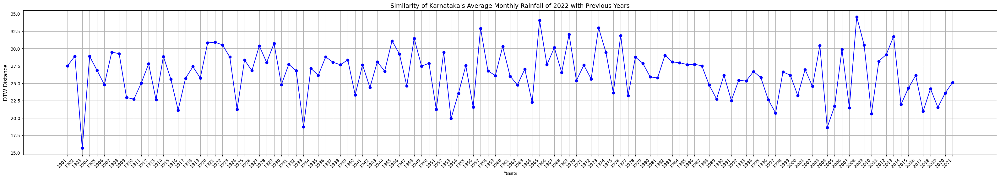

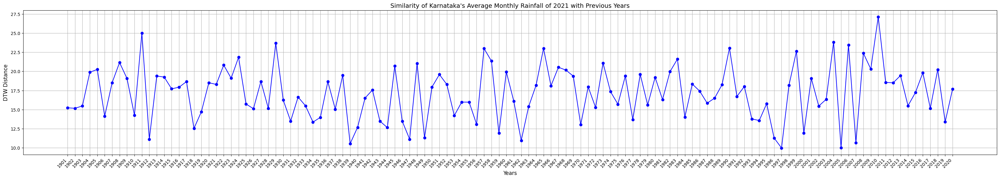

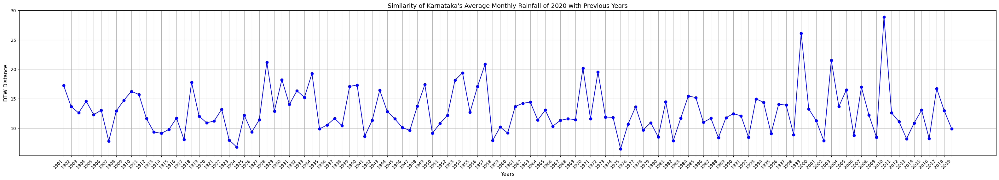

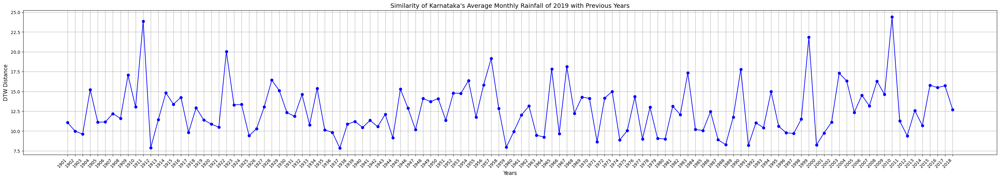

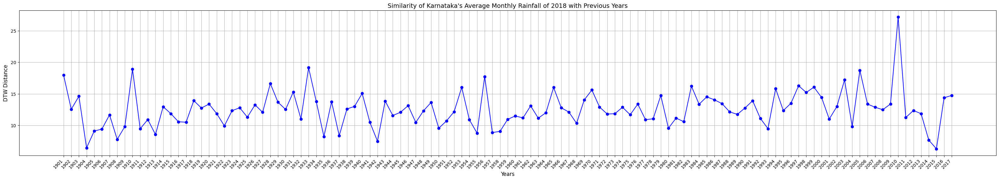

...

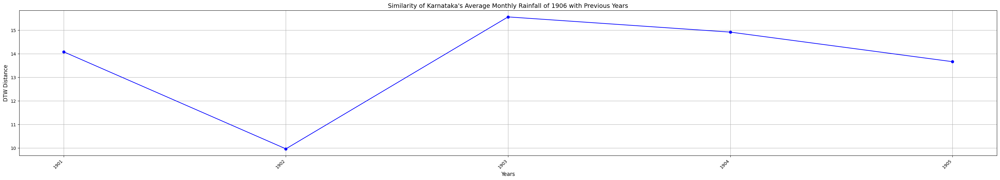

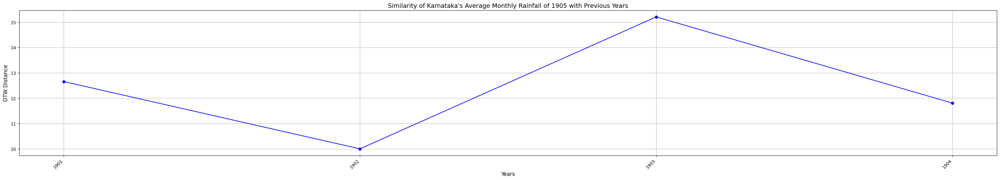

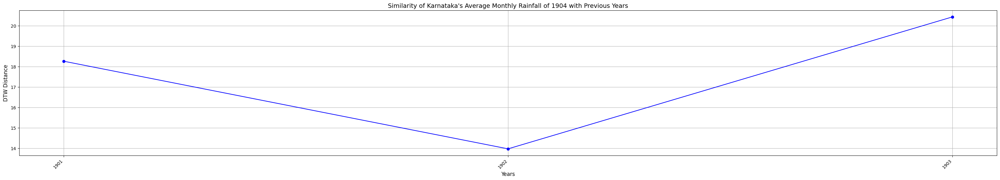

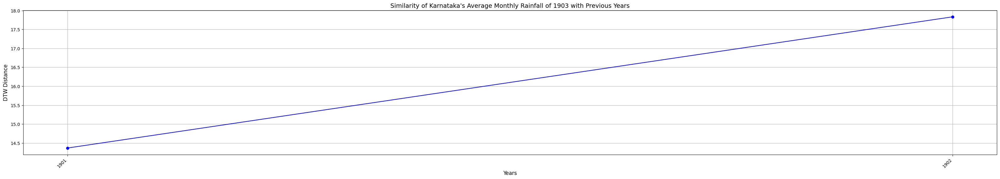

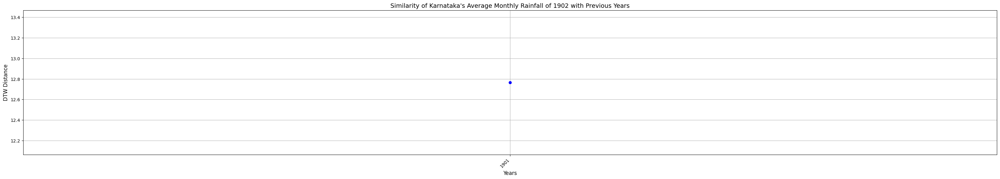

KeyError: ignored

<Figure size 4000x600 with 0 Axes>

In [ ]:
# Loop through each year
for year1 in range(2022, 1900, -1):
    dfs = []

    # Load the rainfall data for the current year
    rainfall_data1 = xr.open_dataset(data_path + f'{year1}.nc')

    # Find latitude and longitude indices within Karnataka's boundaries
    latitude_indices1 = np.where((rainfall_data1['LATITUDE'] >= min_latitude) & (rainfall_data1['LATITUDE'] <= max_latitude))[0]
    longitude_indices1 = np.where((rainfall_data1['LONGITUDE'] >= min_longitude) & (rainfall_data1['LONGITUDE'] <= max_longitude))[0]

    # Slice the rainfall data for Karnataka
    karnataka_rainfall_data1 = rainfall_data1['RAINFALL'][:, latitude_indices1, longitude_indices1]

    # Resample the data to monthly averages
    karnataka_monthly_average_rainfall1 = karnataka_rainfall_data1.resample(TIME='1M').mean()

    for year2 in range(year1 - 1, 1900, -1):
        # Load the rainfall data for the previous years
        rainfall_data2 = xr.open_dataset(data_path + f'{year2}.nc')

        # Find latitude and longitude indices within Karnataka's boundaries for the previous years
        latitude_indices2 = np.where((rainfall_data2['LATITUDE'] >= min_latitude) & (rainfall_data2['LATITUDE'] <= max_latitude))[0]
        longitude_indices2 = np.where((rainfall_data2['LONGITUDE'] >= min_longitude) & (rainfall_data2['LONGITUDE'] <= max_longitude))[0]

        # Slice the rainfall data for Karnataka for the previous years
        karnataka_rainfall_data2 = rainfall_data2['RAINFALL'][:, latitude_indices2, longitude_indices2]

        # Resample the data to monthly averages
        karnataka_monthly_average_rainfall2 = karnataka_rainfall_data2.resample(TIME='1M').mean()

        # Calculate DTW distance
        dtw_distance, _ = fastdtw(karnataka_monthly_average_rainfall1, karnataka_monthly_average_rainfall2)

        # Store the DTW distance and the corresponding year
        dfs.append({'Year': year2, 'DTW Distance': dtw_distance})

    # Create a DataFrame from the list of dictionaries
    result_df = pd.DataFrame(dfs)

    # Plot the DTW distances with adjusted font size and plot size
    plt.figure(figsize=(40, 6))
    plt.plot(result_df['Year'], result_df['DTW Distance'], marker='o', linestyle='-', color='b')
    plt.xlabel('Years', fontsize=12)
    plt.ylabel('DTW Distance', fontsize=12)
    plt.title(f'Similarity of Karnataka\'s Average Monthly Rainfall of {year1} with Previous Years', fontsize=14)
    plt.xticks(result_df['Year'], rotation=45, ha='right', fontsize=10)
    plt.grid(True)
    plt.show()


Convert NetCdF to Dataframe

In [ ]:
import pandas as pd

dfs = []

for year in range(1901, 2023):
    # Load the rainfall data for the current year
    rainfall_data = xr.open_dataset(data_path + f'{year}.nc')

    months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

    # Find latitude and longitude indices within Karnataka's boundaries
    latitude_indices = np.where((rainfall_data['LATITUDE'] >= min_latitude) & (rainfall_data['LATITUDE'] <= max_latitude))[0]
    longitude_indices = np.where((rainfall_data['LONGITUDE'] >= min_longitude) & (rainfall_data['LONGITUDE'] <= max_longitude))[0]

    # Slice the rainfall data for Karnataka
    karnataka_rainfall_data = rainfall_data['RAINFALL'][:, latitude_indices, longitude_indices]

    # Resample the data to monthly sums
    karnataka_monthly_sum_rainfall = karnataka_rainfall_data.resample(TIME='1M').sum()

    df_year = pd.DataFrame({
        'Year': [year] * len(karnataka_monthly_sum_rainfall['TIME']),
        'Month': karnataka_monthly_sum_rainfall['TIME'].dt.strftime('%b'),
        'Monthly Rainfall': karnataka_monthly_sum_rainfall.values.flatten()
    })

    # Append the DataFrame to the list
    dfs.append(df_year)

# Concatenate all DataFrames into a single DataFrame
result_df = pd.concat(dfs, ignore_index=True)

# Pivot the DataFrame to have months as columns
result_df_pivoted = result_df.pivot_table(index='Year', columns='Month', values='Monthly Rainfall', aggfunc='sum', fill_value=0)

# Add a column for Total Annual Rainfall
result_df_pivoted['Total Annual Rainfall'] = result_df_pivoted.sum(axis=1)

# Reset index to make 'Year' a column again
result_df_pivoted = result_df_pivoted.reset_index()

# Display the resulting DataFrame
print(result_df_pivoted)


Month  Year         Apr         Aug        Dec        Feb        Jan  \
0      1901   14.074141   27.627516   3.521007  14.379114  10.385771   
1      1902   85.429574   37.671367  54.620825   0.000000   0.540919   
2      1903   24.646298  103.119622   8.205794   0.000000   0.000000   
3      1904   83.236378    6.711721   0.000000   0.000000   0.000000   
4      1905   14.718260   71.308105   0.000000   6.700213   0.000000   
..      ...         ...         ...        ...        ...        ...   
117    2018   66.856799   42.221080   0.714539   2.356547   0.000000   
118    2019   45.794232  188.094562   3.616390   3.363642   0.000000   
119    2020   48.324971  163.931745   4.959494   0.214268   0.000000   
120    2021   52.673279  133.301492  45.183622   7.043666  11.868773   
121    2022  118.091730  271.969171  20.043178   0.000000   0.382789   

Month         Jul        Jun        Mar         May         Nov         Oct  \
0       33.081242  44.048444   0.000000  148.842137   80

TOTAL ANNUAL RAINFALL (1901 TO 2022)

In [ ]:
from scipy.stats import zscore

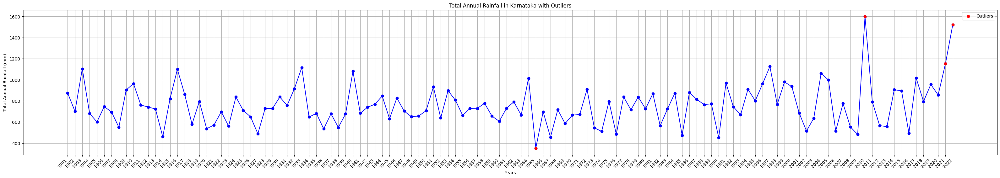

Number of Outliers: 4
Outlier Years: [1965, 2010, 2021, 2022]
Outlier Values: [352.406859844923, 1599.131544828415, 1152.3126590400934, 1522.495594754815]


In [ ]:
# Calculate the Z-scores for the 'Total Annual Rainfall' column
z_scores = zscore(result_df_pivoted['Total Annual Rainfall'])

# Define a threshold for identifying outliers (e.g., Z-score greater than 2)
outlier_threshold = 2

# Identify outlier indices
outlier_indices = np.where(np.abs(z_scores) > outlier_threshold)[0]

# Plot the line graph with outliers highlighted
plt.figure(figsize=(40, 6))
plt.plot(result_df_pivoted['Year'], result_df_pivoted['Total Annual Rainfall'], marker='o', linestyle='-', color='b')
plt.scatter(result_df_pivoted['Year'].iloc[outlier_indices], result_df_pivoted['Total Annual Rainfall'].iloc[outlier_indices], color='r', label='Outliers',  zorder=5)
plt.xlabel('Years')
plt.ylabel('Total Annual Rainfall (mm)')
plt.title('Total Annual Rainfall in Karnataka with Outliers')
plt.xticks(np.arange(min(result_df_pivoted['Year']), max(result_df_pivoted['Year']) + 1, 1), rotation=45, ha='right')
plt.legend()
plt.grid(True)
plt.show()

# Print information about outliers
print(f"Number of Outliers: {len(outlier_indices)}")
print(f"Outlier Years: {result_df_pivoted['Year'].iloc[outlier_indices].tolist()}")
print(f"Outlier Values: {result_df_pivoted['Total Annual Rainfall'].iloc[outlier_indices].tolist()}")

MONTHLY RAINFALL TIME SERIES GRAPH FOR EACH YEAR

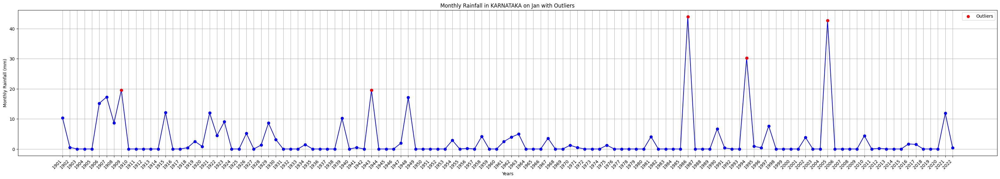

Number of Outliers: 5
Outlier Years: [1909, 1943, 1986, 1994, 2005]
Outlier Values: [19.60087299346924, 19.560871243476868, 43.98582363128662, 30.280202955007553, 42.657724633812904]


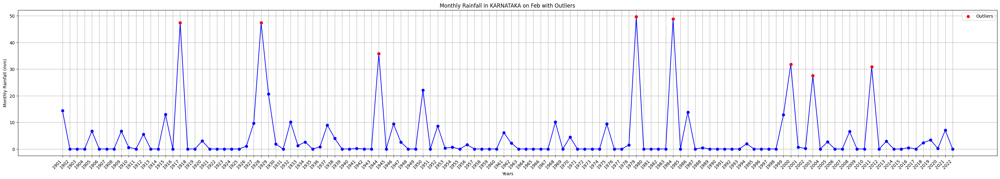

Number of Outliers: 8
Outlier Years: [1917, 1928, 1944, 1979, 1984, 2000, 2003, 2011]
Outlier Values: [47.45177722722292, 47.43434298038483, 35.7589225769043, 49.68985638022423, 48.773704528808594, 31.824742436408997, 27.567646026611328, 30.84304040670395]


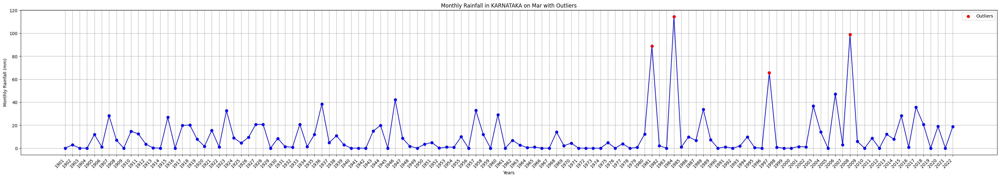

Number of Outliers: 4
Outlier Years: [1981, 1984, 1997, 2008]
Outlier Values: [88.94515228271484, 114.5800712108612, 65.74844442307949, 99.06966364383698]


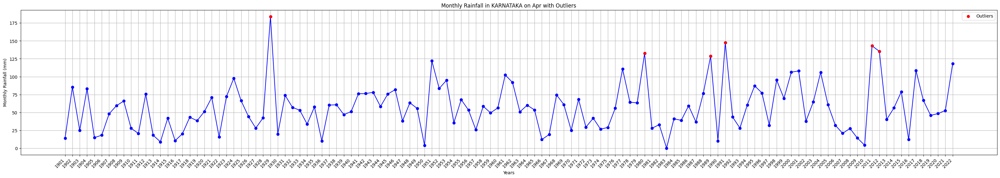

Number of Outliers: 6
Outlier Years: [1929, 1980, 1989, 1991, 2011, 2012]
Outlier Values: [184.04411762952805, 132.4806491136551, 128.51756845414639, 147.687659740448, 143.11647240817547, 135.43059387803078]


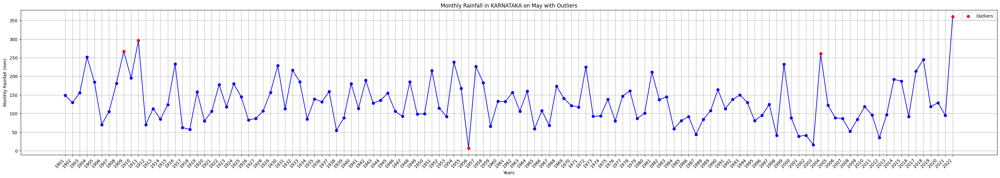

Number of Outliers: 5
Outlier Years: [1909, 1911, 1956, 2004, 2022]
Outlier Values: [266.7574037462473, 295.96319872140884, 6.905278995633125, 261.0752172321081, 360.44843658804893]


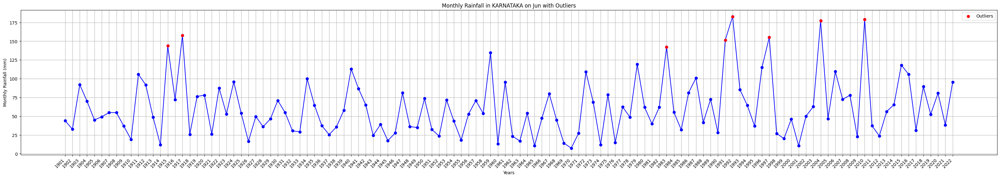

Number of Outliers: 8
Outlier Years: [1915, 1917, 1983, 1991, 1992, 1997, 2004, 2010]
Outlier Values: [143.76679557561874, 157.65979643166065, 142.26454854011536, 151.63187438249588, 182.91048300266266, 155.2214151620865, 177.15973538160324, 179.23278826475143]


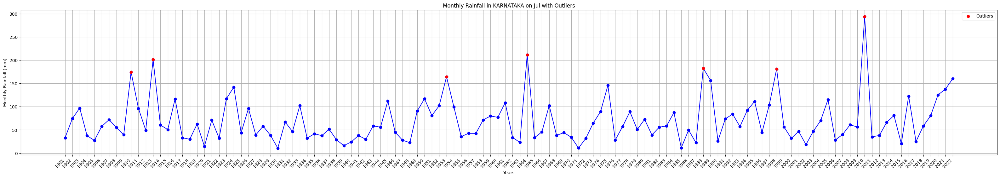

Number of Outliers: 7
Outlier Years: [1910, 1913, 1953, 1964, 1988, 1998, 2010]
Outlier Values: [174.73888763785362, 201.144857943058, 164.45180928707123, 211.68135623633862, 182.54568429291248, 181.21461375057697, 294.1291708648205]


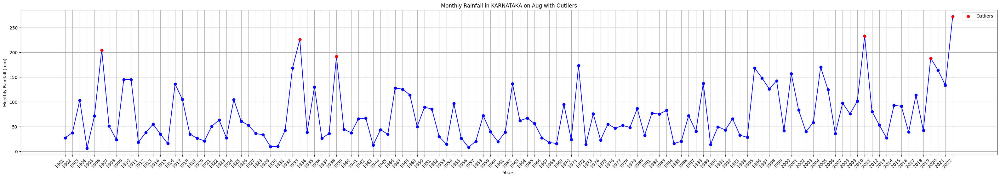

Number of Outliers: 6
Outlier Years: [1906, 1933, 1938, 2010, 2019, 2022]
Outlier Values: [204.3187989294529, 225.54283925145864, 191.62063013017178, 232.4344683289528, 188.09456160664558, 271.969171077013]


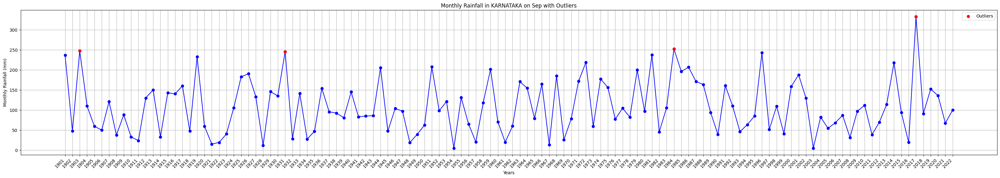

Number of Outliers: 4
Outlier Years: [1903, 1931, 1984, 2017]
Outlier Values: [247.3482542783022, 245.04975951462984, 252.3362552523613, 332.83363581448793]


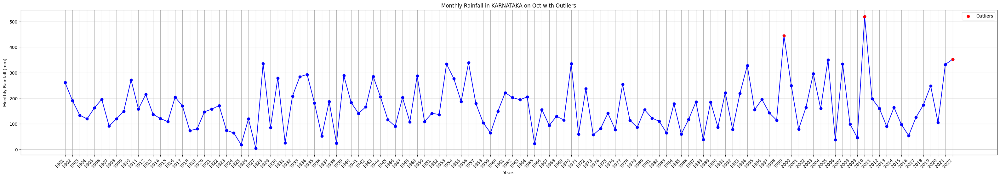

Number of Outliers: 3
Outlier Years: [1999, 2010, 2022]
Outlier Values: [444.66932183504105, 519.8070984631777, 352.4245225042105]


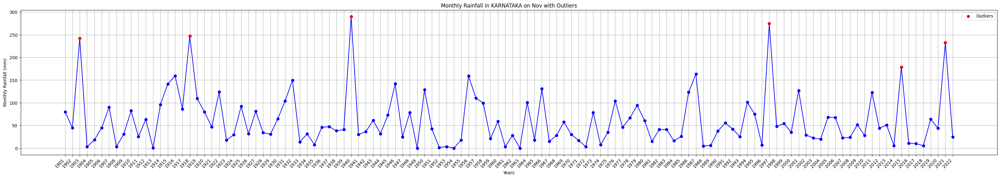

Number of Outliers: 6
Outlier Years: [1903, 1918, 1940, 1997, 2015, 2021]
Outlier Values: [242.15063059329987, 246.77389784157276, 290.0148099511862, 274.3442339003086, 178.47255486249924, 232.27384984493256]


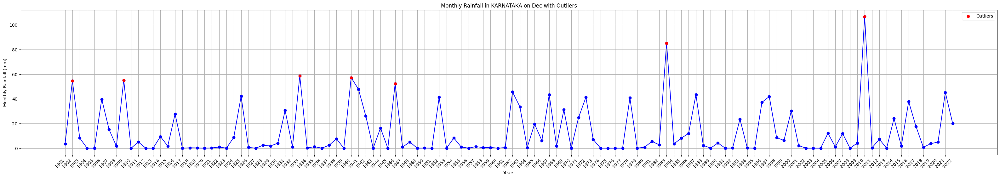

Number of Outliers: 7
Outlier Years: [1902, 1909, 1933, 1940, 1946, 1983, 2010]
Outlier Values: [54.62082453072071, 55.19178485870361, 58.56695404648781, 57.212281465530396, 52.38196591287851, 85.1406681239605, 106.71549832820892]


In [ ]:
for month in months:
  # Calculate the Z-scores for the 'month' column
  z_scores = zscore(result_df_pivoted[month])

  # Define a threshold for identifying outliers (e.g., Z-score greater than 2)
  outlier_threshold = 2

  # Identify outlier indices
  outlier_indices = np.where(np.abs(z_scores) > outlier_threshold)[0]

  # Plot the line graph with outliers highlighted
  plt.figure(figsize=(40, 6))
  plt.plot(result_df_pivoted['Year'], result_df_pivoted[month], marker='o', linestyle='-', color='b')
  plt.scatter(result_df_pivoted['Year'].iloc[outlier_indices], result_df_pivoted[month].iloc[outlier_indices], color='r', label='Outliers',  zorder=5)
  plt.xlabel('Years')
  plt.ylabel('Monthly Rainfall (mm)')
  plt.title(f'Monthly Rainfall in KARNATAKA on {month} with Outliers')
  plt.xticks(np.arange(min(result_df_pivoted['Year']), max(result_df_pivoted['Year']) + 1, 1), rotation=45, ha='right')
  plt.legend()
  plt.grid(True)
  plt.show()

  # Print information about outliers
  print(f"Number of Outliers: {len(outlier_indices)}")
  print(f"Outlier Years: {result_df_pivoted['Year'].iloc[outlier_indices].tolist()}")
  print(f"Outlier Values: {result_df_pivoted[month].iloc[outlier_indices].tolist()}")

 MEAN, STANDARD DEVIATION, RANGE OF TOTAL ANNUAL RAINFALL, POINT OF HIGHEST AND LOWEST RAINFALL

In [ ]:
mean = np.mean(result_df_pivoted['Total Annual Rainfall'] )
std = np.std(result_df_pivoted['Total Annual Rainfall'] )
print(f"Mean of Total Annual Rainfall: {mean} mm")
print(f"Standard deviation of Total Annual Rainfall: {std} mm")
print(f"Range of Total Annual Rainfall: {mean - std}mm <= Rainfall <= {mean + std}mm")
print('\n')
max_rainfall_year = result_df_pivoted.loc[result_df_pivoted['Total Annual Rainfall'].idxmax(), 'Year']
max_rainfall_value = result_df_pivoted['Total Annual Rainfall'].max()

print(f"Year with the Highest Rainfall: {max_rainfall_year}")
print(f"Highest Rainfall Value: {max_rainfall_value} mm")
print('\n')
min_rainfall_year = result_df_pivoted.loc[result_df_pivoted['Total Annual Rainfall'].idxmin(), 'Year']
min_rainfall_value = result_df_pivoted['Total Annual Rainfall'].min()

print(f"Year with the Lowest Rainfall: {min_rainfall_year}")
print(f"Lowest Rainfall Value: {min_rainfall_value} mm")

Mean of Total Annual Rainfall: 757.1408889862846 mm
Standard deviation of Total Annual Rainfall: 195.57813644582149 mm
Range of Total Annual Rainfall: 561.5627525404632mm <= Rainfall <= 952.719025432106mm


Year with the Highest Rainfall: 2010
Highest Rainfall Value: 1599.131544828415 mm


Year with the Lowest Rainfall: 1965
Lowest Rainfall Value: 352.406859844923 mm


YEARS WITH ANNUAL RAINFALL ABOVE 95 PERCENTILE AND BELOW 5 PERCENTILE FOR YEARS FROM 2010 TO 2022

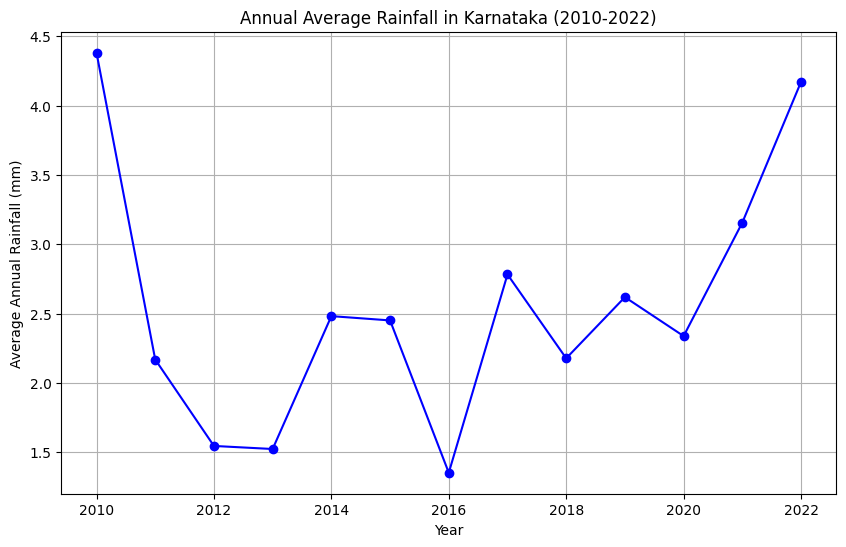

Years above 95th percentile: [2010]
Years below 5th percentile: [2016]


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr



# Initialize an empty list to store annual average rainfall
annual_averages = []

# Loop through each year in the specified range (2010 to 2022)
for year in range(2010, 2023):
    # Load the rainfall data for the current year
    rainfall_data = xr.open_dataset(data_path + f'{year}.nc')

    # Find latitude and longitude indices within Karnataka's boundaries
    latitude_indices = np.where((rainfall_data['LATITUDE'] >= min_latitude) & (rainfall_data['LATITUDE'] <= max_latitude))[0]
    longitude_indices = np.where((rainfall_data['LONGITUDE'] >= min_longitude) & (rainfall_data['LONGITUDE'] <= max_longitude))[0]

    # Slice the rainfall data for Karnataka
    Karnataka_rainfall_data = rainfall_data['RAINFALL'][:, latitude_indices, longitude_indices]

    # Calculate the annual average rainfall
    annual_average_rainfall = Karnataka_rainfall_data.mean(dim='TIME').sum().item()
    annual_averages.append(annual_average_rainfall)

    # Close the NetCDF dataset to free up resources
    rainfall_data.close()

# Plot the annual average rainfall
plt.figure(figsize=(10, 6))
plt.plot(range(2010, 2023), annual_averages, marker='o', linestyle='-', color='b')
plt.xlabel('Year')
plt.ylabel('Average Annual Rainfall (mm)')
plt.title('Annual Average Rainfall in Karnataka (2010-2022)')
plt.grid(True)
plt.show()

# Calculate percentiles
percentile_5 = np.percentile(annual_averages, 5)
percentile_95 = np.percentile(annual_averages, 95)

# Print years above 95th percentile
above_95 = [year for year, avg in zip(range(2010, 2023), annual_averages) if avg > percentile_95]
print(f'Years above 95th percentile: {above_95}')

# Print years below 5th percentile
below_5 = [year for year, avg in zip(range(2010, 2023), annual_averages) if avg < percentile_5]
print(f'Years below 5th percentile: {below_5}')


10 year Interval Rainfall average

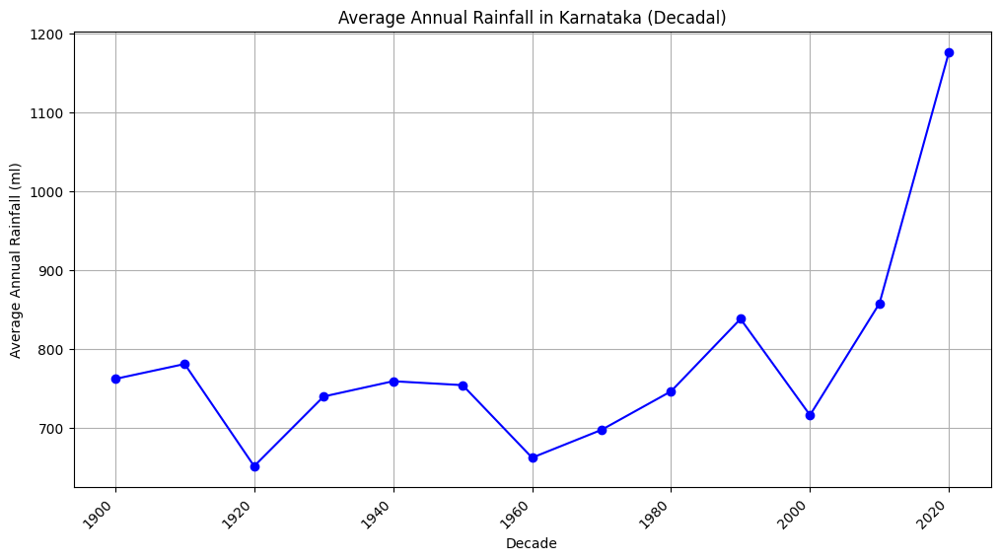

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr


# Calculate average annual rainfall across each 10 years
result_df_pivoted['Decade'] = (result_df_pivoted['Year'] // 10) * 10
decadal_average_rainfall = result_df_pivoted.groupby('Decade')['Total Annual Rainfall'].mean()

# Plot the decadal average annual rainfall as a line plot
plt.figure(figsize=(12, 6))
plt.plot(decadal_average_rainfall.index, decadal_average_rainfall, marker='o', color='b', linestyle='-')
plt.xlabel('Decade')
plt.ylabel('Average Annual Rainfall (ml)')
plt.title(f'Average Annual Rainfall in Karnataka (Decadal)')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.show()

MONTHLY RAINFALL ANALYSIS FROM 1901 TO 2022

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr



# Calculate average annual rainfall across each 10 years
result_df_pivoted['Decade'] = (result_df_pivoted['Year'] // 10) * 10
decadal_average_rainfall = result_df_pivoted.groupby('Decade')['Total Annual Rainfall'].mean()

# Print the mean and standard deviation
mean_rainfall = decadal_average_rainfall.mean()
std_rainfall = decadal_average_rainfall.std()

print(f"Mean Annual Rainfall: {mean_rainfall} mm")
print(f"Standard Deviation of Annual Rainfall: {std_rainfall} mm")

Mean Annual Rainfall: 779.7770756830008 mm
Standard Deviation of Annual Rainfall: 133.21563039083753 mm


Mann-Kendall and Sen Test for Trend Analysis

Mann-Kendall test : A non-parametric statistical test used to assess the presence of trends in time series data by evaluating the monotonicity of the data over time.
Sen Slope Estimator : A method for estimating the slope of a trend in time series data

In [ ]:
!pip install pymannkendall

In [ ]:
!pip install --upgrade pymannkendall

In [ ]:
from scipy.stats import kendalltau, norm, linregress

In [ ]:
print(result_df)

for 2021to22

In [ ]:
# Filter the DataFrame for the desired years (2022 to 2012)
print("Enter the range of years(year1 to year2)")
year1 = int(input())
year2 = int(input())
selected_years = range(year2, year1-1, -1)
df_selected_years = result_df_pivoted[result_df_pivoted['Year'].isin(selected_years)]

result, _ = kendalltau(df_selected_years['Year'],df_selected_years['Total Annual Rainfall'])

# Calculate p-value for the Mann-Kendall test
p_value = 2 * norm.cdf(-abs(result))

# Display Mann-Kendall test result
print("Mann-Kendall Test Result for Yearly Sum of Rainfall (2022 to 2012):")
print(f"Kendall's Tau: {result}")
print(f"P-value: {p_value}")
if p_value < 0.05:
    if result > 0:
        print("Significant positive trend")
    elif result < 0:
        print("Significant negative trend")
    else:
        print("No significant trend")
else:
    print("No significant trend")

Enter the range of years(year1 to year2)
2021
2022
Mann-Kendall Test Result for Yearly Sum of Rainfall (2022 to 2012):
Kendall's Tau: 1.0
P-value: 0.31731050786291415
No significant trend


for 2017 to 2022

In [ ]:
# Filter the DataFrame for the desired years (2022 to 2012)
print("Enter the range of years(year1 to year2)")
year1 = int(input())
year2 = int(input())
selected_years = range(year2, year1-1, -1)
df_selected_years = result_df_pivoted[result_df_pivoted['Year'].isin(selected_years)]

result, _ = kendalltau(df_selected_years['Year'],df_selected_years['Total Annual Rainfall'])

# Calculate p-value for the Mann-Kendall test
p_value = 2 * norm.cdf(-abs(result))

# Display Mann-Kendall test result
print("Mann-Kendall Test Result for Yearly Sum of Rainfall (2022 to 2012):")
print(f"Kendall's Tau: {result}")
print(f"P-value: {p_value}")
if p_value < 0.05:
    if result > 0:
        print("Significant positive trend")
    elif result < 0:
        print("Significant negative trend")
    else:
        print("No significant trend")
else:
    print("No significant trend")

Enter the range of years(year1 to year2)
2017
2022
Mann-Kendall Test Result for Yearly Sum of Rainfall (2022 to 2012):
Kendall's Tau: 0.4666666666666666
P-value: 0.6407383818025407
No significant trend


Pettit test

A non-parametric statistical test used to detect a change point or discontinuity in a time series, indicating a significant shift in the distribution of the data.

In [ ]:
!pip install ruptures

In [ ]:
!pip install pyhomogeneity

In [ ]:
import pyhomogeneity as hg

# Data generation for analysis
data = np.random.rand(360,1)

result = hg.pettitt_test(data)
print(result)

Pettitt_Test(h=False, cp=158, p=0.8238, U=2386.0, avg=mean(mu1=0.49045095831908364, mu2=0.5280091476932488))


In [ ]:
# Filter the DataFrame for the desired years (2022 to 2012)
print("Enter the range of years (year1 to year2)")
year1 = int(input())
year2 = int(input())
selected_years = range(year1, year2 + 1)
df_selected_years = result_df_pivoted[result_df_pivoted['Year'].isin(selected_years)]

# Perform Pettitt test for the selected years
result_pettitt = hg.pettitt_test(df_selected_years['Total Annual Rainfall'])

# Display Pettitt test result
print(f"Pettitt Test Result for Yearly Sum of Rainfall ({year1} to {year2}):")
print(f"Change detected: {result_pettitt.h}")
print(f"Change point index: {result_pettitt.cp}")
print(f"P-value: {result_pettitt.p}")
print(f"Test Statistic (U): {result_pettitt.U}")
print(f"Mean Before Change (mu1): {result_pettitt.avg.mu1}")
print(f"Mean After Change (mu2): {result_pettitt.avg.mu2}")

Enter the range of years (year1 to year2)
2017
2020
Pettitt Test Result for Yearly Sum of Rainfall (2017 to 2020):
Change detected: False
Change point index: 1
P-value: 0.3381
Test Statistic (U): 3.0
Mean Before Change (mu1): 1015.6920009925961
Mean After Change (mu2): 868.9472394039234


In [ ]:
# Filter the DataFrame for the desired years (2022 to 2012)
print("Enter the range of years (year1 to year2)")
year1 = int(input())
year2 = int(input())
selected_years = range(year1, year2 + 1)
df_selected_years = result_df_pivoted[result_df_pivoted['Year'].isin(selected_years)]

# Perform Pettitt test for the selected years
result_pettitt = hg.pettitt_test(df_selected_years['Jan'])

# Display Pettitt test result
print(f"Pettitt Test Result for Monthly Rainfall of January ({year1} to {year2}):")
print(f"Change detected: {result_pettitt.h}")
print(f"Change point index: {result_pettitt.cp}")
print(f"P-value: {result_pettitt.p}")
print(f"Test Statistic (U): {result_pettitt.U}")
print(f"Mean Before Change (mu1): {result_pettitt.avg.mu1}")
print(f"Mean After Change (mu2): {result_pettitt.avg.mu2}")